# File Path Locations

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
# Path to all the input data
data_path = '/content/drive/MyDrive/IST 718 Project/Data/input_data/'

In [3]:
# Path to csv output data
output_path = '/content/drive/MyDrive/IST 718 Project/Data/final_outputs/'

In [4]:
# Path to graph outputs
output_graph = '/content/drive/MyDrive/IST 718 Project/Data/output_graphs/'

# Libraries

In [5]:
# For NLTK
!pip install -q nrclex
!python -m -q nltk.downloader vader_lexicon

# For ANN
!pip install -q -U keras-tuner

     |████████████████████████████████| 396 kB 11.8 MB/s 
/usr/bin/python3: No module named -q
     |████████████████████████████████| 98 kB 5.2 MB/s 


In [6]:
import pandas as pd
import numpy as np

import time
import timeit
from statistics import mean
import math

from datetime import datetime
from datetime import timezone

# Visuals
import plotly.express as px
import requests

import seaborn as sns  # PROVIDES TRELLIS AND SMALL MULTIPLE PLOTTING
import matplotlib.pyplot as plt #2D plotting

# Modeling Piece
import statsmodels.api as sm 
import statsmodels.formula.api as smf
from scipy.stats import uniform
from sklearn.model_selection import train_test_split
from sklearn import datasets, linear_model

# Linear Regression
from sklearn.linear_model import LinearRegression

# KNN
from sklearn.neighbors import KNeighborsClassifier

# Decision Tree and Random Forest
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier

# K Means
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler, scale, StandardScaler
from sklearn import metrics
from scipy.spatial.distance import cdist

# Import the SVM library from sklearn
from sklearn.svm import SVC

# Import the gridsearch library
from sklearn.model_selection import GridSearchCV
from tabulate import tabulate

# Bayes
from sklearn.naive_bayes import GaussianNB

# ANN
import tensorflow as tf
from tensorflow import keras
import keras_tuner as kt
from tensorflow.keras.utils import to_categorical
from keras.models import Sequential
from keras.layers import Dense,Activation,Dropout 
from keras.utils import np_utils

# Colormap
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.cm import register_cmap

# Sampling character data
import random
from random import sample

# NLP modules
from nltk.sentiment.vader import SentimentIntensityAnalyzer as SIA
from nrclex import NRCLex
import nltk, os

nltk.download('punkt')
nltk.download('vader_lexicon')

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.

/usr/local/lib/python3.7/dist-packages/nltk/twitter/__init__.py:20: UserWarning:

The twython library has not been installed. Some functionality from the twitter package will not be available.



[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package vader_lexicon to /root/nltk_data...


True

In [7]:
my_colorlist = ['#ffc800','#e98f42','#ca8478','#79af96','#48a8a6']
my_colorblue = ["#48a8a6"]
my_colormap = LinearSegmentedColormap.from_list('mycolormap', my_colorlist,N=100)
register_cmap("mycolormap", my_colormap)
cpal = sns.color_palette("mycolormap", n_colors=10)

# Obtain and Scrub

### NLP Character Script Sentiment Analysis

Using scripts from popular television shows to do a sentiment analysis on dialogue for main characters in Futurama, Rick and Morty, and The Office(US). The scripts were from Kaggle. The datasets have columns for season, episode, character, and lines(dialogue) from the specified episode. The goal is to get an overall sentiment score of positive, negative, and neutral for each character. 

Further analysis looks at the characters NRC emotion lexicon score. This won't be used for the later model. but does give a more indepth view of specific characters to validate the original sentiment score.

In [8]:
# Starting the timer
start_nlp = timeit.default_timer()

##### Futurama Scripts from [Kaggle](https://www.kaggle.com/josephvm/futurama-seasons-16-transcripts)

This dataset contains the first 6 seasons of Futurama with dialogue('Line') for each character, the name of the episode the chartacter and dialogiue appeared, and the season number.

In [9]:
# Using pandas to load in first 6 seasons of Futurama 

all_lines_df = pd.read_csv(data_path+'futurama_scripts.csv')
all_lines_df.head()

,Season,Episode,Character,Line
0,1,Space Pilot 3000,Fry,Space. It seems to go on and on forever. But ...
1,1,Space Pilot 3000,Fry,And that's how you play the game!
2,1,Space Pilot 3000,Boy,"You stink, loser!"
3,1,Space Pilot 3000,Panucci,"Hey, Fry. Pizza goin' out! C'mon!!"
4,1,Space Pilot 3000,Fry,"Michelle, baby! Where you going?"


In [10]:
# Checking for missing data 

all_lines_df.isna().sum()

Season       0
Episode      0
Character    0
Line         5
dtype: int64

In [11]:
# Data does not need much cleaning but there are missing values. 
# Only one of the missing values is from a primary character so the rows can be dropped. 

all_lines_df[all_lines_df['Line'].isna()]

,Season,Episode,Character,Line
2754,6,Fry Am the Egg Man,Man #1,NaN
19830,5,Bender's Game Part 1,ALL,NaN
20442,5,Bender's Game Part 4,ALL,NaN
22836,6,Lethal Inspection,Hermes,NaN
23485,6,The Prisoner of Benda,Bender,NaN


In [12]:
# Dropping NaN 

all_lines_df = all_lines_df.dropna(axis=0)

In [13]:
# Adding two columns 'Num Chars' and 'Num Words'
# This will help give a scope of the data and will be used for sentiment analysis later

all_lines_df['Num Chars'] = all_lines_df['Line'].apply(lambda x: len(x))
all_lines_df['Num Words'] = all_lines_df['Line'].apply(lambda x: len(x.split()))
all_lines_df.head(3)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Season,Episode,Character,Line,Num Chars,Num Words
0,1,Space Pilot 3000,Fry,Space. It seems to go on and on forever. But ...,117,24
1,1,Space Pilot 3000,Fry,And that's how you play the game!,34,7
2,1,Space Pilot 3000,Boy,"You stink, loser!",18,3


In [14]:
# Lowercasing Line data to prepare for sentiment analysis. 
# Stripping any leading or trailing spaces. 

all_lines_df['Line'] = all_lines_df['Line'].str.strip()
all_lines_df['Line'] = all_lines_df['Line'].apply(lambda x: x.lower())

In [15]:
# Checking lowercase 
# Picking random dialogue Line column

all_lines_df.Line[200]

'not necessarily. are you three, by any chance, interested in becoming my new spaceship crew?'

In [16]:
# Checking characters by most lines per episode to determine main characters to focus on. 

pd.DataFrame(all_lines_df.groupby('Character')['Episode'].nunique().sort_values(ascending=False).head(10))

,Episode
Character,
Bender,114
Leela,114
Fry,114
Farnsworth,112
Zoidberg,108
Hermes,105
Amy,101
Man,45
Zapp,33


It's surprising to see the character 'Man' has more dialogue than Zapp.

In [17]:
# Setting top 7 characters  

top7 = all_lines_df['Character'].value_counts()[:7]
top7

Fry           3791
Bender        3395
Leela         2998
Farnsworth    1730
Zoidberg       888
Amy            863
Hermes         771
Name: Character, dtype: int64

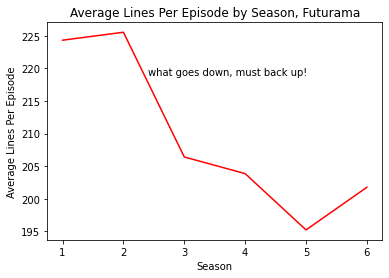

In [18]:
# Plotting to see average lines per episode per season

fig, ax = plt.subplots()
lines_per_season = all_lines_df.groupby(['Season', 'Episode'])['Line'].count().groupby('Season').mean()
lines_per_season.plot(ax=ax, c='r')
plt.ylabel('Average Lines Per Episode')
plt.text(2.4,219,all_lines_df.Line[576]) # using Fry's line to describe trend
plt.title('Average Lines Per Episode by Season, Futurama');

Season five has the lowest amount of lines compared to any other season. The decrease in dialogue starts in seaosn 2. The dialogue seems to increase again after season 5. 

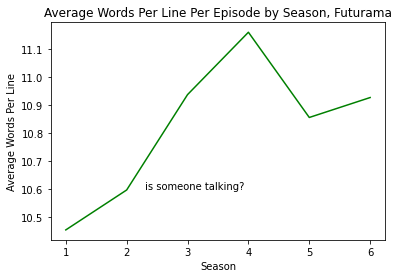

In [19]:
# Average words per line per episode

fig, ax = plt.subplots()
avg_words_per_line_per_season = all_lines_df.groupby(['Season', 'Episode'])['Num Words'].mean().groupby('Season').mean()
avg_words_per_line_per_season.plot(ax=ax, c='g')
plt.ylabel('Average Words Per Line')
plt.text(2.3,10.6,all_lines_df.Line[22357]) #using Zoidberg's line
plt.title('Average Words Per Line Per Episode by Season, Futurama');

This shows an increase in words per line in each episode starting in seaosn 2. This matches the trend in the previous graph. So it appears there is a trend of more broken up dialogue to start and then into more lines per character later. 

In [20]:
# Setting up dataframe for sentiment analysis 
# Character's average number of words per line, number of characters per line, and average characters per word

top_seven_df = all_lines_df[all_lines_df['Character'].isin(top7.index.tolist())]
avg_word_line = top_seven_df.groupby('Character')[['Num Words', 'Num Chars']].mean().sort_values(by='Num Words', ascending=False)
avg_word_line['Avg Word Length'] = avg_word_line['Num Chars'] / avg_word_line['Num Words']
avg_word_line

,Num Words,Num Chars,Avg Word Length
Character,,,
Farnsworth,13.348555,75.076301,5.624302
Bender,10.561708,56.934021,5.390607
Leela,10.167111,54.881588,5.397953
Hermes,10.114137,55.927367,5.529623
Zoidberg,9.826577,53.599099,5.454504
Fry,9.784490,52.196782,5.334645
Amy,7.712630,42.399768,5.497446


Professor Farnsworth's lines the most amount of words, but most characters are averaging aorund the same. 

##### Futurama Sentiment Analysis

In [21]:
# Combinng all the lines

all_text = ""
for i, row in all_lines_df.iterrows():
    all_text = all_text + row['Line'] + ' '

In [22]:
# Beginning sentiment analysis

pos_neg_sentiment = {}

# Setting frame for the lines of the top seven 
top7_joined_lines = all_lines_df.groupby('Character').apply(lambda x: " ".join(x['Line']))[top7.index]

sia = SIA()

# Get overall sentiment
pos_neg_sentiment['Overall'] = sia.polarity_scores(all_text)

# Get sentiment for each character
for character in top7_joined_lines.index:
    pos_neg_sentiment[character] = sia.polarity_scores(top7_joined_lines[character])

In [23]:
pn_sentiment = pd.DataFrame(pos_neg_sentiment).T
pn_sentiment.columns = ['Negative', 'Neutral', 'Positive', 'Compound']
pn_sentiment[['Positive', 'Negative', 'Neutral']].sort_values(by='Positive', ascending=False)

,Positive,Negative,Neutral
Amy,0.195,0.110,0.694
Zoidberg,0.186,0.142,0.672
Bender,0.184,0.136,0.680
Fry,0.179,0.118,0.703
Overall,0.174,0.125,0.701
Hermes,0.166,0.112,0.722
Leela,0.164,0.127,0.710
Farnsworth,0.135,0.149,0.716


The most positive character is Amy. I guess that is not a surprise. Zoidberg and Bender have the highest negative sentiment, which sounds correct. 

In [24]:
# Putting Futurama Sentiment findings into csv 

pn_sentiment.to_csv(output_path+'futurama_sentiment.csv')

**NRC** Emotion Analysis

The NRCLex library. Emotional affect is measured for 8 different emotions, along with positive and negative. Those 8 emotions are:


*   Anger
*   Anticipation
*   Disgust
*   Fear
*   Joy
*  Sadness
*   Surprise
*   Trust

In [25]:
# Setting up dict for NRC sentiment analysis 
top7_nrc_dict = {}

# Get the emotion frequencies for the characters
for character in top7_joined_lines.index:
    text_object = NRCLex(top7_joined_lines[character])
    top7_nrc_dict[character] = text_object.affect_frequencies

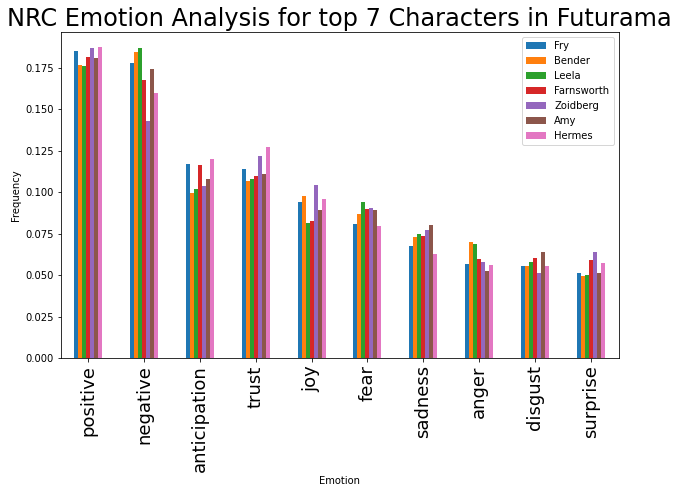

In [26]:
# Plot it

fig, ax = plt.subplots(figsize=(10,6))
plt.title('NRC Emotion Analysis for top 7 Characters in Futurama', size=24)
plt.xlabel('Emotion')
plt.ylabel('Frequency')
ax.tick_params(axis='x', labelsize=18)
nrc_df = pd.DataFrame(top7_nrc_dict).drop(['anticip'], axis=0).sort_values(by='Fry', ascending=False)
nrc_df.plot.bar(ax=ax);

It's interesting to see anticipation has such a high score, but surprise is the lowest. 

In [27]:
nrc_df

,Fry,Bender,Leela,Farnsworth,Zoidberg,Amy,Hermes
positive,0.185185,0.176518,0.176151,0.181537,0.186961,0.180935,0.187132
negative,0.177844,0.184658,0.186751,0.167620,0.142750,0.174256,0.159493
anticipation,0.116700,0.099196,0.102082,0.116592,0.103410,0.108075,0.119619
trust,0.114070,0.106725,0.108013,0.109788,0.121768,0.111111,0.127322
joy,0.094236,0.097874,0.081388,0.082418,0.104159,0.089253,0.095605
fear,0.080649,0.086987,0.093880,0.089995,0.090296,0.089253,0.079293
sadness,0.067390,0.072744,0.074953,0.073759,0.077182,0.080146,0.062528
anger,0.056870,0.069997,0.068644,0.059378,0.058074,0.052216,0.056185
disgust,0.055556,0.055652,0.058044,0.059997,0.051330,0.063752,0.055732
surprise,0.051501,0.049649,0.050095,0.058914,0.064069,0.051002,0.057091


Overall the sentiment scores look correct. Bender has the highest anger score, and highest joy which could be accounting for the amount of emotion he is often willing to show as a character.

##### Rick and Morty Scripts from [kaggle](https://www.kaggle.com/andradaolteanu/rickmorty-scripts)

In [28]:
# Rick and Morty Season 1-3 scripts 
# Data includes season number, episode number, episode names, character names, and dialogue 
# Renaming columns for easier analysis 

RandM_all_lines_df = pd.read_csv(data_path+'rick_and_morty_scripts.csv', header=0,
                                 names= ['season_no', 'episode_no','episode_name','character','line'])
RandM_all_lines_df.head()

,season_no,episode_no,episode_name,character,line
0,1,1,Pilot,Rick,Morty! You gotta come on. Jus'... you gotta co...
1,1,1,Pilot,Morty,"What, Rick? What’s going on?"
2,1,1,Pilot,Rick,"I got a surprise for you, Morty."
3,1,1,Pilot,Morty,It's the middle of the night. What are you tal...
4,1,1,Pilot,Rick,"Come on, I got a surprise for you. Come on, h..."


In [29]:
# Checking for missing data 

RandM_all_lines_df.isna().sum()

season_no       0
episode_no      0
episode_name    0
character       0
line            0
dtype: int64

In [30]:
# Adding two columns 'Num Chars' and 'Num Words'

RandM_all_lines_df['NumChars'] = RandM_all_lines_df['line'].apply(lambda x: len(x))
RandM_all_lines_df['Num Words'] = RandM_all_lines_df['line'].apply(lambda x: len(x.split()))
RandM_all_lines_df.head(3)

,season_no,episode_no,episode_name,character,line,NumChars,Num Words
0,1,1,Pilot,Rick,Morty! You gotta come on. Jus'... you gotta co...,57,11
1,1,1,Pilot,Morty,"What, Rick? What’s going on?",28,5
2,1,1,Pilot,Rick,"I got a surprise for you, Morty.",32,7


In [31]:
# Lowercasing all dialogue and striping spaces.

RandM_all_lines_df['line'] = RandM_all_lines_df['line'].str.strip()
RandM_all_lines_df['line'] = RandM_all_lines_df['line'].apply(lambda x: x.lower())

In [32]:
# loking at character spread

top5 = RandM_all_lines_df['character'].value_counts()[:5]
top5

Rick      420
Morty     347
Beth      148
Jerry     132
Summer     97
Name: character, dtype: int64

In [33]:
# Looking at number of appearances of the characters to make sure there aren't any characters being forgotten

pd.DataFrame(RandM_all_lines_df.groupby('character')['episode_name'].nunique().sort_values(ascending=False).head(10))

,episode_name
character,
Rick,11
Summer,10
Morty,10
Beth,10
Jerry,8
Mr. Goldenfold,5
Announcer,3
Principal Vagina,3
Birdperson,2


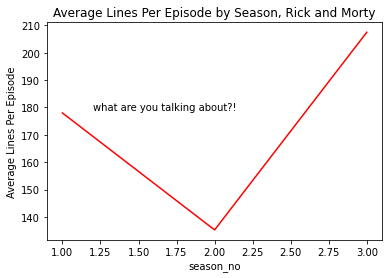

In [34]:
# Looking at average lines per episode per season

fig, ax = plt.subplots()
RandM_lines_per_season = RandM_all_lines_df.groupby(['season_no', 'episode_name'])['line'].count().groupby('season_no').mean()
RandM_lines_per_season.plot(ax=ax, c='r')
plt.ylabel('Average Lines Per Episode')
plt.text(1.2,179,RandM_all_lines_df.line[1662]) 
plt.title('Average Lines Per Episode by Season, Rick and Morty');

After season two there is a large increase in lines per episode.

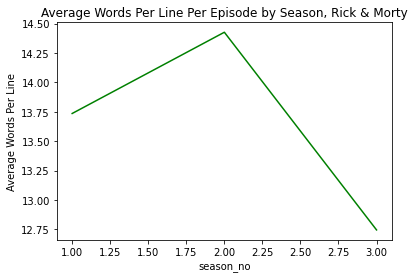

In [35]:
# Average words per line per episode
fig, ax = plt.subplots()
RandM_avg_words_per_line_per_season = RandM_all_lines_df.groupby(['season_no', 'episode_name'])['Num Words'].mean().groupby('season_no').mean()
RandM_avg_words_per_line_per_season.plot(ax=ax, c='g')
plt.ylabel('Average Words Per Line')
plt.title('Average Words Per Line Per Episode by Season, Rick & Morty');

Like in the Futurama dialogue the trend shows the opposite of the first graph. 
There is a decrease in words per line after season two. 

In [36]:
# Character's average number of words per line, number of characters per line, and average characters per word

top_five_df = RandM_all_lines_df[RandM_all_lines_df['character'].isin(top5.index.tolist())]
RandM_avg_word_line = top_five_df.groupby('character')[['Num Words', 'NumChars']].mean().sort_values(by='Num Words', ascending=False)
RandM_avg_word_line['Avg Word Length'] = RandM_avg_word_line['NumChars'] / RandM_avg_word_line['Num Words']
RandM_avg_word_line

,Num Words,NumChars,Avg Word Length
character,,,
Rick,17.719048,95.400000,5.384037
Jerry,13.856061,72.583333,5.238382
Beth,11.128378,58.682432,5.273224
Summer,10.000000,53.082474,5.308247
Morty,9.639769,51.296830,5.321375


##### Rick and Morty Sentiment Analysis

In [37]:
# Combine all the lines
all_text = ""
for i, row in RandM_all_lines_df.iterrows():
    all_text = all_text + row['line'] + ' '

In [38]:
RandM_pos_neg_sentiment = {}

top5_joined_lines = RandM_all_lines_df.groupby('character').apply(lambda x: " ".join(x['line']))[top5.index]

sia = SIA()

# Get overall sentiment
RandM_pos_neg_sentiment['Overall'] = sia.polarity_scores(all_text)

# Get sentiment for each character
for name in top5_joined_lines.index:
    RandM_pos_neg_sentiment[name] = sia.polarity_scores(top5_joined_lines[name])
    
RandM_pn_sentiment = pd.DataFrame(RandM_pos_neg_sentiment).T
RandM_pn_sentiment.columns = ['Negative', 'Neutral', 'Positive', 'Compound']
RandM_pn_sentiment[['Positive', 'Negative', 'Neutral']].sort_values(by='Positive', ascending=False)

,Positive,Negative,Neutral
Morty,0.171,0.124,0.705
Overall,0.155,0.122,0.723
Beth,0.154,0.107,0.739
Jerry,0.154,0.083,0.762
Summer,0.144,0.112,0.745
Rick,0.141,0.120,0.739


Morty is the highest in positive and Rick is the lowest, that matches with the theme of the show. 

In [39]:
# Putting Rick and Morty Sentiment findings into csv 

RandM_pn_sentiment.to_csv(output_path+'rick_and_morty_sentiment.csv')

In [40]:
top5_nrc_dict = {}

# Get the emotion frequencies for the characters
for character in top5_joined_lines.index:
    text_object = NRCLex(top5_joined_lines[character])
    top5_nrc_dict[character] = text_object.affect_frequencies

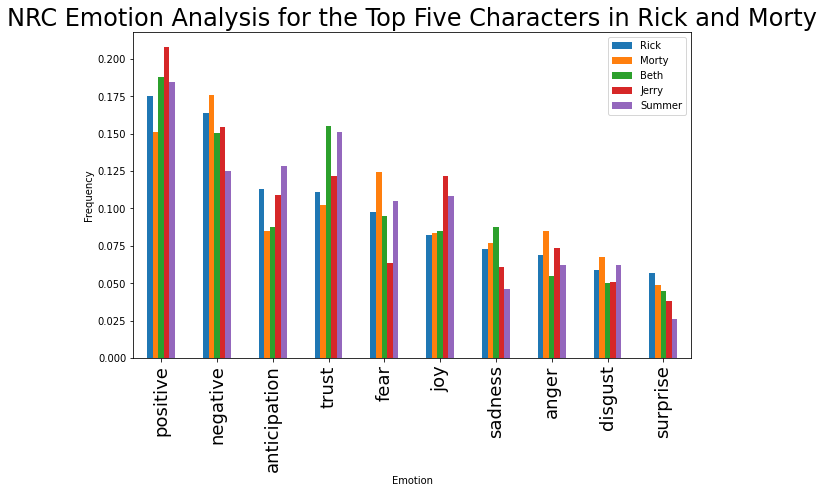

In [41]:
# Plot it NRC and sentiment 

fig, ax = plt.subplots(figsize=(10,6))
plt.title('NRC Emotion Analysis for the Top Five Characters in Rick and Morty', size=24)
plt.xlabel('Emotion')
plt.ylabel('Frequency')
ax.tick_params(axis='x', labelsize=18)
RandM_nrc_df = pd.DataFrame(top5_nrc_dict).drop(['anticip'], axis=0).sort_values(by='Rick', ascending=False)
RandM_nrc_df.plot.bar(ax=ax);

In [42]:
RandM_nrc_df

,Rick,Morty,Beth,Jerry,Summer
positive,0.174867,0.150943,0.187970,0.207595,0.184211
negative,0.163564,0.176101,0.150376,0.154430,0.125000
anticipation,0.113032,0.084906,0.087719,0.108861,0.128289
trust,0.111037,0.102201,0.155388,0.121519,0.151316
fear,0.097739,0.124214,0.095238,0.063291,0.105263
joy,0.082447,0.083333,0.085213,0.121519,0.108553
sadness,0.073138,0.077044,0.087719,0.060759,0.046053
anger,0.069149,0.084906,0.055138,0.073418,0.062500
disgust,0.058511,0.067610,0.050125,0.050633,0.062500
surprise,0.056516,0.048742,0.045113,0.037975,0.026316


Overall the scores look accurate. The highest fear score is Morty, and the lowest trust. While the highest trust is Beth, which is the character who has the least amount of negative story archs or conflict. 

##### Seinfeld Scrips from [Kaggle](https://www.kaggle.com/thec03u5/seinfeld-chronicles)

In [43]:
# Loading scrip and episode data for all 9 seasons of Seinfeld episodes
# Data includes character, dialogue, episode number, episode and seaosn id, and season

sf_all_lines_df = pd.read_csv(data_path+'seinfeld_scripts.csv', 
                              header =0, 
                              names=['Character','Line','EpisodeNo','SEID','Season'])
sf_all_lines_df.tail()

,Character,Line,EpisodeNo,SEID,Season
54611,JERRY,Grand theft auto - don't steal any of my jokes.,23.0,S09E23,9.0
54612,PRISONER 3,You suck - I'm gonna cut you.,23.0,S09E23,9.0
54613,JERRY,"Hey, I don't come down to where you work, and ...",23.0,S09E23,9.0
54614,GUARD,"Alright, Seinfeld, that's it. Let's go. Come on.",23.0,S09E23,9.0
54615,JERRY,"Alright, hey, you've been great! See you in th...",23.0,S09E23,9.0


In [44]:
# Checking for missing data 

sf_all_lines_df.isna().sum()

Character     0
Line         10
EpisodeNo     0
SEID          0
Season        0
dtype: int64

In [45]:
# Dropping NaN
# Since there are so many lines in this set dropping ten should not effect the results 

sf_all_lines_df = sf_all_lines_df.dropna(axis=0)

In [46]:
# Checking for missing data 
# No more!

sf_all_lines_df.isna().sum()

Character    0
Line         0
EpisodeNo    0
SEID         0
Season       0
dtype: int64

In [47]:
# Adding two columns 'Num Chars' and 'Num Words'

sf_all_lines_df['NumChars'] = sf_all_lines_df['Line'].apply(lambda x: len(x))
sf_all_lines_df['Num Words'] = sf_all_lines_df['Line'].apply(lambda x: len(x.split()))
sf_all_lines_df.head(3)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Character,Line,EpisodeNo,SEID,Season,NumChars,Num Words
0,JERRY,Do you know what this is all about? Do you kno...,1.0,S01E01,1.0,974,189
1,JERRY,"(pointing at Georges shirt) See, to me, that b...",1.0,S01E01,1.0,225,41
2,GEORGE,Are you through?,1.0,S01E01,1.0,16,3


In [48]:
# Lowercase and removing white space through all text 

sf_all_lines_df['Line'] = sf_all_lines_df['Line'].str.strip()
sf_all_lines_df['Line'] = sf_all_lines_df['Line'].apply(lambda x: x.lower())

In [49]:
# Looking at number of appearances of the characters 
# Top 8 for all the main characters 

pd.DataFrame(sf_all_lines_df.groupby('Character')['EpisodeNo'].nunique().sort_values(ascending=False).head(8))

,EpisodeNo
Character,
ELAINE,24
KRAMER,24
GEORGE,24
JERRY,24
MAN,21
SUSAN,21
NEWMAN,20
WOMAN,19


In [50]:
# Setting the main four characters 

top4 = sf_all_lines_df['Character'].value_counts()[:4]
top4

JERRY     14786
GEORGE     9708
ELAINE     7983
KRAMER     6664
Name: Character, dtype: int64

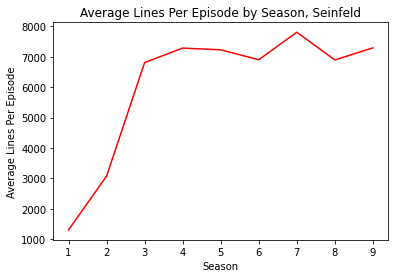

In [51]:
# Average lines per episode per season
fig, ax = plt.subplots()
df_lines_per_season = sf_all_lines_df.groupby(['Season'])['Line'].count().groupby('Season').mean()
df_lines_per_season.plot(ax=ax, c='r')
plt.ylabel('Average Lines Per Episode')
plt.title('Average Lines Per Episode by Season, Seinfeld');

Since this television show has more seaosn than the rest it's easier to see the spread. It's far less dramatic than both Futurama and Rick and Morty. The first change in average lines is the slowing after seaosn 2, but it increases again in season 5 to 6.

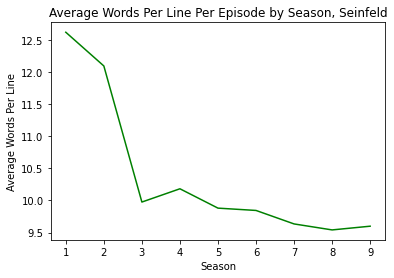

In [52]:
# Average words per line per episode
fig, ax = plt.subplots()
sf_avg_words_per_line_per_season = sf_all_lines_df.groupby(['Season'])['Num Words'].mean().groupby('Season').mean()
sf_avg_words_per_line_per_season.plot(ax=ax, c='g')
plt.ylabel('Average Words Per Line')
plt.title('Average Words Per Line Per Episode by Season, Seinfeld');

This is following the same trends.

In [53]:
# Character's average number of words per line, number of characters per line, and average characters per word

top_four_df = sf_all_lines_df[sf_all_lines_df['Character'].isin(top4.index.tolist())]
sf_avg_word_line = top_four_df.groupby('Character')[['Num Words', 'NumChars']].mean().sort_values(by='Num Words', ascending=False)
sf_avg_word_line['Avg Word Length'] = sf_avg_word_line['NumChars'] / sf_avg_word_line['Num Words']
sf_avg_word_line

,Num Words,NumChars,Avg Word Length
Character,,,
GEORGE,11.024825,57.719304,5.235394
KRAMER,10.549070,55.434274,5.254897
JERRY,9.968146,52.046125,5.221244
ELAINE,9.349117,48.742453,5.213589


##### Seinfeld Sentiment Analysis

In [54]:
# Combine all the lines

all_text = ""
for i, row in sf_all_lines_df.iterrows():
    all_text = all_text + row['Line'] + ' '

In [55]:
# Beginning Sentiment Analysis
sf_pos_neg_sentiment = {}

top4_joined_lines = sf_all_lines_df.groupby('Character').apply(lambda x: " ".join(x['Line']))[top4.index]

sia = SIA()

# Get overall sentiment
sf_pos_neg_sentiment['Overall'] = sia.polarity_scores(all_text)

# Get sentiment for each character
for Character in top4_joined_lines.index:
    sf_pos_neg_sentiment[Character] = sia.polarity_scores(top4_joined_lines[Character])
    
sf_pn_sentiment = pd.DataFrame(sf_pos_neg_sentiment).T
sf_pn_sentiment.columns = ['Negative', 'Neutral', 'Positive', 'Compound']
sf_pn_sentiment[['Positive', 'Negative', 'Neutral']].sort_values(by='Positive', ascending=False)

,Positive,Negative,Neutral
KRAMER,0.186,0.059,0.755
Overall,0.158,0.087,0.755
GEORGE,0.151,0.098,0.750
JERRY,0.139,0.100,0.761
ELAINE,0.133,0.113,0.755


This sentiment analysis took the most time. There is so much dialogue both putting all the text together and then running analysis took 17 minutes.

In [56]:
# Saving findings to csv 

sf_pn_sentiment.to_csv(output_path+'seinfeld_sentiment.csv')

In [57]:
top4_nrc_dict = {}

# Get the emotion frequencies for the characters
for character in top4_joined_lines.index:
    text_object = NRCLex(top4_joined_lines[character])
    top4_nrc_dict[character] = text_object.affect_frequencies

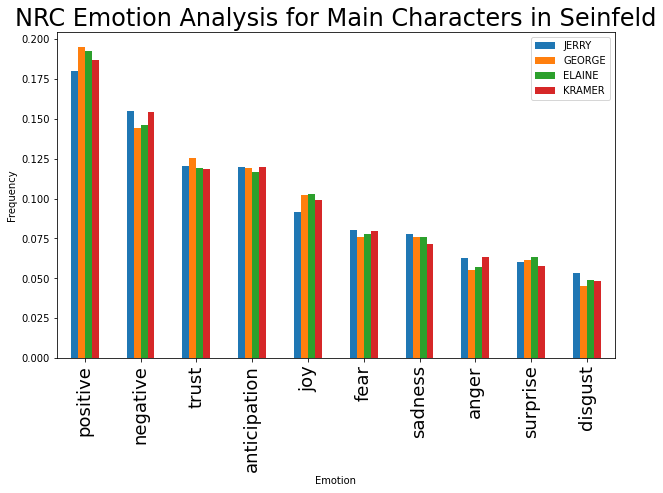

In [58]:
# Plotting NRC Emotional Analysis Results

fig, ax = plt.subplots(figsize=(10,6))
plt.title('NRC Emotion Analysis for Main Characters in Seinfeld', size=24)
plt.xlabel('Emotion')
plt.ylabel('Frequency')
ax.tick_params(axis='x', labelsize=18)
sf_nrc_df = pd.DataFrame(top4_nrc_dict).drop(['anticip'], axis=0).sort_values(by='JERRY', ascending=False)
sf_nrc_df.plot.bar(ax=ax);

In [59]:
sf_nrc_df

,JERRY,GEORGE,ELAINE,KRAMER
positive,0.179869,0.194807,0.192385,0.186672
negative,0.154764,0.144390,0.146068,0.154519
trust,0.120264,0.125334,0.119270,0.118784
anticipation,0.119601,0.119208,0.116631,0.119700
joy,0.091533,0.102351,0.102712,0.098959
fear,0.080384,0.076174,0.077594,0.079717
sadness,0.077694,0.075703,0.075834,0.071803
anger,0.062451,0.055233,0.057355,0.063474
surprise,0.060268,0.061567,0.063275,0.057893
disgust,0.053173,0.045233,0.048876,0.048480


Of all the shows Seinfeld is the one I know least about. Jerry being the most negative, and having the highest fear score seems close to the character in the show. Kramer having the highest anticipation score is accurate. 

##### The Office (US) Scripts from [Kaggle](https://www.kaggle.com/nasirkhalid24/the-office-us-complete-dialoguetranscript)

In [60]:
# Loading in 9 seasons of the US Office scripts 
# Includes season, episode, title of episode, scene, character, and their dialogue

office_all_lines_df = pd.read_csv(data_path+'the_office_scripts.csv')
office_all_lines_df.head()

,season,episode,title,scene,speaker,line,Unnamed: 6
0,1,1,Pilot,1,Michael,All right Jim. Your quarterlies look very good...,NaN
1,1,1,Pilot,1,Jim,"Oh, I told you. I couldn't close it. So...",NaN
2,1,1,Pilot,1,Michael,So you've come to the master for guidance? Is ...,NaN
3,1,1,Pilot,1,Jim,"Actually, you called me in here, but yeah.",NaN
4,1,1,Pilot,1,Michael,"All right. Well, let me show you how it's done.",NaN


In [61]:
# Dropping empty column 

office_all_lines_df.drop(columns=['Unnamed: 6'],inplace=True)

In [62]:
# Renameing columns 

office_all_lines_df.rename(columns={'speaker':'character'},inplace=True)

In [63]:
# Checking for missing data 
# No missing data 

office_all_lines_df.isna().sum()

season       0
episode      0
title        0
scene        0
character    0
line         0
dtype: int64

In [64]:
# Adding two columns 'Num Chars' and 'Num Words'

office_all_lines_df['Num Chars'] = office_all_lines_df['line'].apply(lambda x: len(x))
office_all_lines_df['Num Words'] = office_all_lines_df['line'].apply(lambda x: len(x.split()))
office_all_lines_df.head(3)

,season,episode,title,scene,character,line,Num Chars,Num Words
0,1,1,Pilot,1,Michael,All right Jim. Your quarterlies look very good...,78,14
1,1,1,Pilot,1,Jim,"Oh, I told you. I couldn't close it. So...",42,9
2,1,1,Pilot,1,Michael,So you've come to the master for guidance? Is ...,83,14


In [65]:
# Lowercase and removie white space from all text 

office_all_lines_df['line'] = office_all_lines_df['line'].str.strip()
office_all_lines_df['line'] = office_all_lines_df['line'].apply(lambda x: x.lower())

In [66]:
# looking at character spread
# Setting top 18 characters. 

top18 = office_all_lines_df['character'].value_counts()[:18]
top18

Michael     10773
Dwight       6752
Jim          6222
Pam          4973
Andy         3698
Kevin        1535
Angela       1534
Erin         1413
Oscar        1336
Ryan         1182
Darryl       1160
Phyllis       962
Kelly         822
Toby          814
Jan           805
Stanley       671
Meredith      556
Holly         555
Name: character, dtype: int64

In [67]:
# Looking at more full scope of characters to make sure I am not missing any
# 22 is where Creed is but the characters before him are not as important so I decided to leave them out
pd.DataFrame(office_all_lines_df.groupby('character')['episode'].nunique().sort_values(ascending=False).head(25))

,episode
character,
Kevin,28
Erin,28
Angela,28
Stanley,28
Dwight,28
Oscar,28
Andy,28
Pam,28
Meredith,28


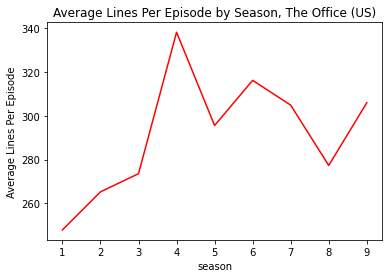

In [68]:
# Average lines per episode per season
fig, ax = plt.subplots()
office_lines_per_season = office_all_lines_df.groupby(['season', 'episode'])['line'].count().groupby('season').mean()
office_lines_per_season.plot(ax=ax, c='r')
plt.ylabel('Average Lines Per Episode')
plt.title('Average Lines Per Episode by Season, The Office (US)');

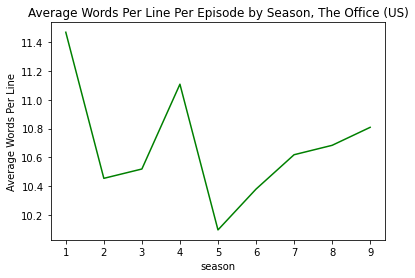

In [69]:
# Average words per line per episode
fig, ax = plt.subplots()
office_avg_words_per_line_per_season = office_all_lines_df.groupby(['season', 'episode'])['Num Words'].mean().groupby('season').mean()
office_avg_words_per_line_per_season.plot(ax=ax, c='g')
plt.ylabel('Average Words Per Line')
plt.title('Average Words Per Line Per Episode by Season, The Office (US)');

The office is showing a slightly different trend than the previous shows. While average lines per epsidoes increase after season 2, the average words after increase just after season 3 and match lines to words. Meaning the characters did not start losing lines, but started to speak more with each line. 

In [70]:
# Character's average number of words per line, number of characters per line, and average characters per word

top_18_df = office_all_lines_df[office_all_lines_df['character'].isin(top18.index.tolist())]
office_avg_word_line = top_18_df.groupby('character')[['Num Words', 'Num Chars']].mean().sort_values(by='Num Words', ascending=False)
office_avg_word_line['Avg Word Length'] = office_avg_word_line['Num Chars'] / office_avg_word_line['Num Words']
office_avg_word_line

,Num Words,Num Chars,Avg Word Length
character,,,
Michael,13.603546,70.537826,5.185253
Andy,11.732558,61.691184,5.258119
Dwight,11.074645,58.798430,5.309284
Kelly,10.726277,54.557178,5.086311
Ryan,9.793570,50.925550,5.199896
Jan,9.729193,50.900621,5.231742
Toby,9.574939,50.072482,5.229536
Darryl,9.300862,48.089655,5.170451
Jim,9.207490,47.789939,5.190333


##### The Office (US) Sentiment Analysis

In [71]:
# Combine all the lines
all_text = ""
for i, row in office_all_lines_df.iterrows():
    all_text = all_text + row['line'] + ' '

In [72]:
# Beginning sentiment analysis 
office_pos_neg_sentiment = {}

top18_joined_lines = office_all_lines_df.groupby('character').apply(lambda x: " ".join(x['line']))[top18.index]

sia = SIA()

# Get overall sentiment
office_pos_neg_sentiment['Overall'] = sia.polarity_scores(all_text)

# Get sentiment for each character
for character in top18_joined_lines.index:
    office_pos_neg_sentiment[character] = sia.polarity_scores(top18_joined_lines[character])
    
office_pn_sentiment = pd.DataFrame(office_pos_neg_sentiment).T
office_pn_sentiment.columns = ['Negative', 'Neutral', 'Positive', 'Compound']
office_pn_sentiment[['Positive', 'Negative', 'Neutral']].sort_values(by='Positive', ascending=False)

,Positive,Negative,Neutral
Jim,0.220,0.074,0.706
Erin,0.216,0.083,0.700
Pam,0.216,0.080,0.703
Jan,0.207,0.056,0.737
Kelly,0.207,0.097,0.696
Andy,0.206,0.090,0.704
Overall,0.204,0.089,0.707
Holly,0.203,0.105,0.692
Kevin,0.197,0.101,0.702
Michael,0.196,0.106,0.698


Much like Seinfeld the amount of data contained within the nine seasons was higher than Futurama and Rick and Morty. It look more time than Seinfeld data to run, finishing after 17 mins and 44 seconds.

In [73]:
office_pn_sentiment.to_csv(output_path+'the_office_Sentiment.csv')

NRC Emotion Analysis
The NRCLex library. Emotional affect is measured for 8 different emotions, along with positive and negative. Those 8 emotions are:


*   Anger
*   Anticipation
*   Disgust
*   Fear
*   Joy
*  Sadness
*   Surprise
*   Trust

In [74]:
top18_nrc_dict = {}

# Get the emotion frequencies for the Crew
for character in top18_joined_lines.index:
    text_object = NRCLex(top18_joined_lines[character])
    top18_nrc_dict[character] = text_object.affect_frequencies

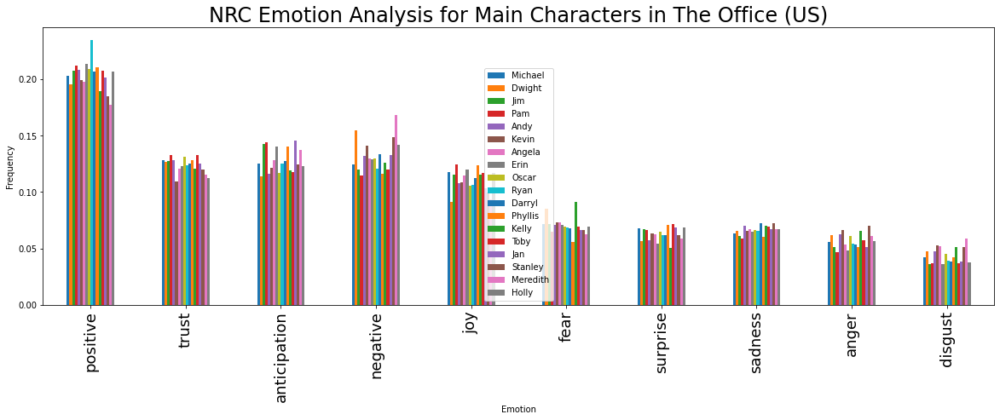

In [75]:
# Plot it
fig, ax = plt.subplots(figsize=(20,6))
plt.title('NRC Emotion Analysis for Main Characters in The Office (US)', size=24)
plt.xlabel('Emotion')
plt.ylabel('Frequency')
ax.tick_params(axis='x', labelsize=18)
office_nrc_df = pd.DataFrame(top18_nrc_dict).drop(['anticip'], axis=0).sort_values(by='Michael', ascending=False)
office_nrc_df.plot.bar(ax=ax);

Ryan's positivity is so much higher thaan the rest of the characters.

In [76]:
office_nrc_df

,Michael,Dwight,Jim,Pam,Andy,Kevin,Angela,Erin,Oscar,Ryan,Darryl,Phyllis,Kelly,Toby,Jan,Stanley,Meredith,Holly
positive,0.203065,0.195489,0.207693,0.211625,0.208203,0.198995,0.197818,0.213740,0.208661,0.234310,0.206943,0.210274,0.189647,0.207547,0.201113,0.184961,0.177624,0.206612
trust,0.128473,0.127134,0.127283,0.132875,0.128088,0.109342,0.120727,0.123035,0.131234,0.123431,0.125338,0.128082,0.120464,0.132801,0.125261,0.120138,0.115340,0.112161
anticipation,0.124953,0.114156,0.142940,0.144125,0.116095,0.121491,0.128000,0.140099,0.117235,0.125000,0.127142,0.140411,0.119497,0.117562,0.145442,0.124460,0.137255,0.122786
negative,0.124504,0.154980,0.119648,0.114375,0.131686,0.141181,0.129818,0.128873,0.129921,0.120816,0.133904,0.116438,0.126270,0.119739,0.132916,0.148660,0.168397,0.141677
joy,0.117911,0.091287,0.115299,0.124125,0.107820,0.108504,0.114909,0.119892,0.105424,0.106695,0.112714,0.123973,0.115143,0.116836,0.103688,0.099395,0.093426,0.116883
fear,0.071969,0.085302,0.071518,0.064750,0.071120,0.072895,0.073455,0.070947,0.069554,0.068515,0.067628,0.055479,0.091437,0.069666,0.066110,0.066551,0.062284,0.069658
surprise,0.067619,0.056385,0.066879,0.066250,0.057208,0.063259,0.062545,0.054333,0.064742,0.062238,0.061767,0.071233,0.050314,0.071843,0.068894,0.062230,0.058824,0.068477
sadness,0.063719,0.065520,0.061274,0.058625,0.069921,0.065354,0.066909,0.064661,0.066492,0.065377,0.072137,0.060274,0.070150,0.069666,0.066806,0.072602,0.066897,0.067296
anger,0.055780,0.061929,0.051029,0.046625,0.062485,0.066192,0.053818,0.048496,0.061242,0.054393,0.053652,0.051370,0.065796,0.057329,0.051496,0.070009,0.061130,0.056671
disgust,0.042008,0.047817,0.036436,0.036625,0.047373,0.052786,0.052000,0.035923,0.045494,0.039226,0.038774,0.042466,0.051282,0.037010,0.038274,0.050994,0.058824,0.037780


Pam and Phyllis have higher joy sentiment than Michael which is surprising. The angriest and saddest character is Stanley. Overall the characters match their personalities within the show. 

##### Sentiment Dataframe Cleaning and Joining

In [77]:
# Putting Futurama sentiment into new frame reseting index and removing over all score
# Adding show title 

futurama = pn_sentiment.drop('Overall').reset_index()
futurama['Show'] = 'Futurama' 
futurama

,index,Negative,Neutral,Positive,Compound,Show
0,Fry,0.118,0.703,0.179,1.0000,Futurama
1,Bender,0.136,0.680,0.184,1.0000,Futurama
2,Leela,0.127,0.710,0.164,1.0000,Futurama
3,Farnsworth,0.149,0.716,0.135,-0.9999,Futurama
4,Zoidberg,0.142,0.672,0.186,0.9999,Futurama
5,Amy,0.110,0.694,0.195,1.0000,Futurama
6,Hermes,0.112,0.722,0.166,0.9999,Futurama


In [78]:
# Putting rick and Morty sentiment into new frame reseting index and removing over all score
# Adding show title 

RickandMorty = RandM_pn_sentiment.drop('Overall').reset_index()
RickandMorty['Show'] = 'Rick&Morty'
RickandMorty

,index,Negative,Neutral,Positive,Compound,Show
0,Rick,0.120,0.739,0.141,0.9990,Rick&Morty
1,Morty,0.124,0.705,0.171,0.9995,Rick&Morty
2,Beth,0.107,0.739,0.154,0.9978,Rick&Morty
3,Jerry,0.083,0.762,0.154,0.9993,Rick&Morty
4,Summer,0.112,0.745,0.144,0.8927,Rick&Morty


In [79]:
# Putting seinfeld sentiment into new frame reseting index and removing over all score
# Adding show title 

Seinfeld = sf_pn_sentiment.drop('Overall').reset_index()
Seinfeld['Show'] = 'Seinfeld'
Seinfeld

,index,Negative,Neutral,Positive,Compound,Show
0,JERRY,0.100,0.761,0.139,1.0,Seinfeld
1,GEORGE,0.098,0.750,0.151,1.0,Seinfeld
2,ELAINE,0.113,0.755,0.133,1.0,Seinfeld
3,KRAMER,0.059,0.755,0.186,1.0,Seinfeld


In [80]:
# Putting the office sentiment into new frame reseting index and removing over all score
# Adding Show title
Office = office_pn_sentiment.drop('Overall').reset_index()
Office['Show'] = 'The_Office'
Office

,index,Negative,Neutral,Positive,Compound,Show
0,Michael,0.106,0.698,0.196,1.0000,The_Office
1,Dwight,0.104,0.716,0.180,1.0000,The_Office
2,Jim,0.074,0.706,0.220,1.0000,The_Office
3,Pam,0.080,0.703,0.216,1.0000,The_Office
4,Andy,0.090,0.704,0.206,1.0000,The_Office
5,Kevin,0.101,0.702,0.197,1.0000,The_Office
6,Angela,0.124,0.707,0.169,1.0000,The_Office
7,Erin,0.083,0.700,0.216,1.0000,The_Office
8,Oscar,0.110,0.735,0.155,1.0000,The_Office
9,Ryan,0.081,0.733,0.186,1.0000,The_Office


In [81]:
# Using Pandas Concat() to join all three 
# changing index name to character

sentiment_df = pd.concat([futurama,RickandMorty,Seinfeld,Office], axis=0, ignore_index=True)
sentiment_df.rename(columns={'index':'Character'}, inplace=True)

In [82]:
# Making character names all the same case
# Rearranging columns 

sentiment_df.Character = sentiment_df.Character.str.title()
sentiment_df = sentiment_df[['Show','Character','Negative','Neutral','Positive','Compound']]

In [83]:
# Checking df

sentiment_df

,Show,Character,Negative,Neutral,Positive,Compound
0,Futurama,Fry,0.118,0.703,0.179,1.0000
1,Futurama,Bender,0.136,0.680,0.184,1.0000
2,Futurama,Leela,0.127,0.710,0.164,1.0000
3,Futurama,Farnsworth,0.149,0.716,0.135,-0.9999
4,Futurama,Zoidberg,0.142,0.672,0.186,0.9999
5,Futurama,Amy,0.110,0.694,0.195,1.0000
6,Futurama,Hermes,0.112,0.722,0.166,0.9999
7,Rick&Morty,Rick,0.120,0.739,0.141,0.9990
8,Rick&Morty,Morty,0.124,0.705,0.171,0.9995
9,Rick&Morty,Beth,0.107,0.739,0.154,0.9978


In [84]:
# Saving to CSV

sentiment_df.to_csv(output_path+'all_sentiment.csv')

In [85]:
# Ending the timer
stop_nlp = timeit.default_timer()

# Printing the length of running the cell in minutes
print('NLP Run Time: ', (stop_nlp-start_nlp))

NLP Run Time:  2613.504386922


### E-commerce Data from [Kaggle](https://www.kaggle.com/mkechinov/ecommerce-behavior-data-from-multi-category-store?select=2019-Oct.csv)

In the world of creating customer personas, many approaches use cookies along with metadata to create a persona. An alternative approach for commerce companies is asking customers which three fictional character they relate to the most and connecting that to their transaction history.

##### Read in the Data and Drop NA Values

In [86]:
# Reading in transaction data from October 2019
oct_2019 = pd.read_csv(data_path+'2019-Oct.csv')

In [87]:
# Total data before scrubbing
all = len(oct_2019)
print(f'Total Data: {all}')

Total Data: 42448764


In [88]:
# Looking for NA values
print('Features with NA Values:')
oct_2019.isna().sum()

Features with NA Values:


event_time              0
event_type              0
product_id              0
category_id             0
category_code    13515609
brand             6117080
price                   0
user_id                 0
user_session            2
dtype: int64

In [89]:
# Dropping NA values
oct_2019.dropna(inplace=True)
print('Features with NA Values After Dropping:')
oct_2019.isna().sum()

Features with NA Values After Dropping:


event_time       0
event_type       0
product_id       0
category_id      0
category_code    0
brand            0
price            0
user_id          0
user_session     0
dtype: int64

##### Filter for Purchase Data Only

In [90]:
# Getting unique event types
print('Event Types included with the data:', oct_2019.event_type.unique())

Event Types included with the data: ['view' 'purchase' 'cart']


In [91]:
# Setting purchase data to variable
purchases = len(oct_2019[oct_2019["event_type"]=="purchase"])

# Finding amount of data left after filtering for purchases
print('Percent of Total Data After Filtering for Purchases: ', (purchases / all)*100)
print(f'Total Data Remaining: {purchases}')

Percent of Total Data After Filtering for Purchases:  1.2945182573513803
Total Data Remaining: 549507


In [92]:
# Filtering data for only purchase data
oct_2019 = oct_2019[oct_2019["event_type"]=="purchase"]

##### Filter for Customers with Multiple Purchases

For further basket analysis down the road, customers who made single purchases are filtered out of the dataset.

In [93]:
# Grouping customers by user ID and counting the number of items purchased by customer
cust_purch = oct_2019.groupby(['user_id']).agg({"product_id":len})

# Finding the total of customers who purchased a single item
print('Total Number of Customers with a Single Purchase: ', len(cust_purch[cust_purch["product_id"]==1]))

# Finding the total of customers who purchased multiple items
cust_purch = cust_purch[cust_purch["product_id"]!=1]
print('Total Number of Customers with Multiple Purchases: ', len(cust_purch))

Total Number of Customers with a Single Purchase:  168003
Total Number of Customers with Multiple Purchases:  95442


In [94]:
# Setting the customers who purchased multiple products to a list
cust_list = cust_purch.index.tolist()

# Filtering data for customers who purchased multiple products
oct_2019 = oct_2019[oct_2019["user_id"].isin(cust_list)]

In [95]:
# Showing the final data remaining
print('Final Data Amount: ', len(oct_2019))
print('Percent of Total Starting Data: ', (len(oct_2019) / all)*100)

Final Data Amount:  381504
Percent of Total Starting Data:  0.8987399491773188


##### Scrubbing the Remaining Data

In [96]:
# Finding data types for the remaining features
oct_2019.dtypes

event_time        object
event_type        object
product_id         int64
category_id        int64
category_code     object
brand             object
price            float64
user_id            int64
user_session      object
dtype: object

Changing event time to datetime format.

In [97]:
oct_2019["event_time"] = pd.to_datetime(oct_2019["event_time"])

Changing product_id, category_id, and user_id to string format.

In [98]:
oct_2019[["product_id","category_id","user_id"]] = oct_2019[["product_id","category_id","user_id"]].astype(str)

In [99]:
# Checking the data types are correct
oct_2019.dtypes

event_time       datetime64[ns, UTC]
event_type                    object
product_id                    object
category_id                   object
category_code                 object
brand                         object
price                        float64
user_id                       object
user_session                  object
dtype: object

Creating a new variable for a unique purchase_id.

In [100]:
# Changing event date to a datetime object
oct_2019["event_date"] = pd.to_datetime(oct_2019["event_time"]).dt.date

# Pulling out just the date timestamp and adding it to the purchase ID column
oct_2019["purchase_id"] = oct_2019["event_date"].apply(lambda x: pd.Timestamp(x).timestamp()).astype(int)

# Adding the user ID string to the date timestamp
oct_2019["purchase_id"] = oct_2019["purchase_id"].astype(str) + oct_2019["user_id"]

In [101]:
# Checking data types
oct_2019.dtypes

event_time       datetime64[ns, UTC]
event_type                    object
product_id                    object
category_id                   object
category_code                 object
brand                         object
price                        float64
user_id                       object
user_session                  object
event_date                    object
purchase_id                   object
dtype: object

In [102]:
# Inspecting the first 10 rows of data
oct_2019[0:10]

,event_time,event_type,product_id,category_id,category_code,brand,price,user_id,user_session,event_date,purchase_id
162,2019-10-01 00:02:14+00:00,purchase,1004856,2053013555631882655,electronics.smartphone,samsung,130.76,543272936,8187d148-3c41-46d4-b0c0-9c08cd9dc564,2019-10-01,1569888000543272936
308,2019-10-01 00:04:37+00:00,purchase,1002532,2053013555631882655,electronics.smartphone,apple,642.69,551377651,3c80f0d6-e9ec-4181-8c5c-837a30be2d68,2019-10-01,1569888000551377651
442,2019-10-01 00:07:07+00:00,purchase,13800054,2053013557418656265,furniture.bathroom.toilet,santeri,54.42,555332717,1dea3ee2-2ded-42e8-8e7a-4e2ad6ae942f,2019-10-01,1569888000555332717
603,2019-10-01 00:09:54+00:00,purchase,4804056,2053013554658804075,electronics.audio.headphone,apple,161.98,551377651,3c80f0d6-e9ec-4181-8c5c-837a30be2d68,2019-10-01,1569888000551377651
618,2019-10-01 00:10:08+00:00,purchase,1002524,2053013555631882655,electronics.smartphone,apple,515.67,524325294,0b74a829-f9d7-4654-b5b0-35bc9822c238,2019-10-01,1569888000524325294
749,2019-10-01 00:12:14+00:00,purchase,4802036,2053013554658804075,electronics.audio.headphone,apple,171.56,533624186,e5ac3caa-e6d5-4d6b-ae06-2c18cd9ca683,2019-10-01,1569888000533624186
860,2019-10-01 00:14:14+00:00,purchase,1004932,2053013555631882655,electronics.smartphone,vivo,463.31,555083442,83d12d1a-5452-4fa0-abbb-d9f492f8b562,2019-10-01,1569888000555083442
1558,2019-10-01 02:19:10+00:00,purchase,1004246,2053013555631882655,electronics.smartphone,apple,736.18,515246296,b7dbae4f-cad3-463e-89ce-41990cf48dea,2019-10-01,1569888000515246296
1649,2019-10-01 02:19:34+00:00,purchase,1005104,2053013555631882655,electronics.smartphone,apple,975.57,555160488,a1395546-c124-456c-9752-0f5cf883c63d,2019-10-01,1569888000555160488
1811,2019-10-01 02:20:11+00:00,purchase,4804055,2053013554658804075,electronics.audio.headphone,apple,189.91,517129864,df8afa49-66e0-4e54-b9ca-4be6de5c9a0f,2019-10-01,1569888000517129864


##### Splitting out category_code into department, sub_department, and item

In [103]:
# Finding the number of periods for category code to see how many departments and sub departments the company has
oct_2019["num_period"] = oct_2019["category_code"].str.count('\.')

In [104]:
# Looking at the first five category codes
oct_2019[oct_2019["num_period"]==3].head()

,event_time,event_type,product_id,category_id,category_code,brand,price,user_id,user_session,event_date,purchase_id,num_period
84047,2019-10-01 04:11:30+00:00,purchase,14300017,2053013557603205653,electronics.audio.music_tools.piano,cortland,76.96,513635452,afea3352-aff7-416a-935e-b74c29ceafa4,2019-10-01,1569888000513635452,3
250082,2019-10-01 06:52:19+00:00,purchase,14300017,2053013557603205653,electronics.audio.music_tools.piano,cortland,76.96,544031447,62321374-abef-4a5c-a291-02e4484ba079,2019-10-01,1569888000544031447,3
490967,2019-10-01 10:14:42+00:00,purchase,14300128,2053013557603205653,electronics.audio.music_tools.piano,yamaha,667.97,523538114,3decf5fc-b916-4c9c-95fc-620022fcf149,2019-10-01,1569888000523538114,3
554126,2019-10-01 11:12:23+00:00,purchase,14300361,2053013557603205653,electronics.audio.music_tools.piano,m-audio,270.37,551923379,41bd68f2-d9b3-40ef-bdb5-62c90fcf1e47,2019-10-01,1569888000551923379,3
591372,2019-10-01 11:46:46+00:00,purchase,14300017,2053013557603205653,electronics.audio.music_tools.piano,cortland,76.96,513424041,2d6c3ff6-8072-4321-99a0-ce7b82b95fdc,2019-10-01,1569888000513424041,3


In [105]:

# Starting the timer
start_time = timeit.default_timer()

# Creating a loop to extract department, sub department, and item from category code
for i, row in oct_2019['category_code'].items():

  cat_list = row.split('.')

  if len(cat_list) == 3:
    oct_2019.at[i, 'department'] = cat_list[0]
    oct_2019.at[i, 'sub_department'] = cat_list[1]
    oct_2019.at[i, 'item'] = cat_list[2]
  elif len(cat_list) == 2:
    oct_2019.at[i, 'department'] = cat_list[0]
    oct_2019.at[i, 'sub_department'] = ''
    oct_2019.at[i, 'item'] = cat_list[1]
  elif len(cat_list) == 4:
    oct_2019.at[i, 'department'] = cat_list[0]
    oct_2019.at[i, 'sub_department'] = cat_list[1]
    oct_2019.at[i, 'item'] = cat_list[3]
  else:
    print(f'Issue with: {row} at index: {i}')

# Ending the timer
stop_time = timeit.default_timer()

# Printing the length of running the cell in minutes
print('Time: ', (stop_time-start_time))

Time:  10.865752462000273


Joining the computer department and the electronics department due to computers being electronics.

In [106]:
oct_2019["department"] = np.where(oct_2019["department"]=="computers","electronics",oct_2019["department"])

##### Outputting the Cleaned Ecom Data to a CSV

In [107]:
oct_2019.to_csv(output_path+'cleaned_ecom_data.csv')

### Assigning characters and sentiment values to customers based on price

The following data relies on the sentiment analysis and E-commerce data from the previous sections. Combining the two datasets allows further examination for the proof of concept idea that customer sentiment ratings based of character choices could be a point of modeling for understanding their spending habits.

In [108]:
# Reading in the ecom data
df = pd.read_csv(output_path+'cleaned_ecom_data.csv')

In [109]:
# Reading in the character sentiment data
df_chars = pd.read_csv(output_path+'/all_sentiment.csv')

In [110]:
# Finding an aggregate score by dividing the positive sentiment by the negative sentiment
df_chars['agg_score'] = scale((df_chars['Positive']/df_chars['Negative']))

In [111]:
# Sorting the aggregate positive and negative score to find the higher positive characters
char_pos = df_chars.sort_values('agg_score', ascending=False)[:12]
pos_list = char_pos['Character'].tolist()
print('Positive Characters: ', pos_list)

Positive Characters:  ['Jan', 'Kramer', 'Jim', 'Pam', 'Erin', 'Ryan', 'Andy', 'Kelly', 'Darryl', 'Kevin', 'Holly', 'Jerry']


In [112]:
# Sorting the aggregate positive and negative score to find the neutral characters
char_neu = df_chars.sort_values('agg_score', ascending=False)[12:23]
neu_list = char_neu['Character'].tolist()
print('Neutral Characters: ', neu_list)

Neutral Characters:  ['Michael', 'Amy', 'Phyllis', 'Dwight', 'Toby', 'George', 'Fry', 'Hermes', 'Beth', 'Oscar', 'Jerry']


In [113]:
# Sorting the aggregate positive and negative score to find the negative characters
char_neg = df_chars.sort_values('agg_score', ascending=False)[23:]
neg_list = char_neg['Character'].tolist()
print('Negative Characters: ', neg_list)

Negative Characters:  ['Morty', 'Angela', 'Bender', 'Zoidberg', 'Leela', 'Summer', 'Meredith', 'Elaine', 'Rick', 'Stanley', 'Farnsworth']


In [114]:
# Grouping users by user ID and aggregating the price each unique customer spent
user_purchases = df.groupby(['user_id']).agg({'price':sum}).reset_index()

In [115]:
# Starting the timer
start_sentiment = timeit.default_timer()

# Setting a random seed due to sampling
random.seed(73)

# Creating a loop to group customers based on prices and assign them positive, neutral, or negative characters
for i, row in user_purchases['price'].items():

  # For customers who spend the most, assign three positive characters
  if row > 527.65:
    chars = sample(pos_list,3)

    user_purchases.at[i, 'character1'] = chars[0]
    user_purchases.at[i, 'character2'] = chars[1]
    user_purchases.at[i, 'character3'] = chars[2]

    char_row1 = df_chars.loc[df_chars['Character'] == chars[0]]
    char_row2 = df_chars.loc[df_chars['Character'] == chars[1]]
    char_row3 = df_chars.loc[df_chars['Character'] == chars[2]]

    user_purchases.at[i, 'pos_rating'] = ((char_row1['Positive'].values[0] + char_row2['Positive'].values[0] + char_row3['Positive'].values[0])/3)
    user_purchases.at[i, 'neu_rating'] = ((char_row1['Neutral'].values[0] + char_row2['Neutral'].values[0] + char_row3['Neutral'].values[0])/3)
    user_purchases.at[i, 'neg_rating'] = ((char_row1['Negative'].values[0] + char_row2['Negative'].values[0] + char_row3['Negative'].values[0])/3)
    user_purchases.at[i, 'comp_rating'] = ((char_row1['Compound'].values[0] + char_row2['Compound'].values[0] + char_row3['Compound'].values[0])/3)

  # For customers who spend a moderate amount, assign three neutral characters
  elif 135.08 <= row < 527.65:
    chars = sample(neu_list,3)

    user_purchases.at[i, 'character1'] = chars[0]
    user_purchases.at[i, 'character2'] = chars[1]
    user_purchases.at[i, 'character3'] = chars[2]

    char_row1 = df_chars.loc[df_chars['Character'] == chars[0]]
    char_row2 = df_chars.loc[df_chars['Character'] == chars[1]]
    char_row3 = df_chars.loc[df_chars['Character'] == chars[2]]

    user_purchases.at[i, 'pos_rating'] = ((char_row1['Positive'].values[0] + char_row2['Positive'].values[0] + char_row3['Positive'].values[0])/3)
    user_purchases.at[i, 'neu_rating'] = ((char_row1['Neutral'].values[0] + char_row2['Neutral'].values[0] + char_row3['Neutral'].values[0])/3)
    user_purchases.at[i, 'neg_rating'] = ((char_row1['Negative'].values[0] + char_row2['Negative'].values[0] + char_row3['Negative'].values[0])/3)
    user_purchases.at[i, 'comp_rating'] = ((char_row1['Compound'].values[0] + char_row2['Compound'].values[0] + char_row3['Compound'].values[0])/3)

  # For customers who spend the least, assign three negative characters
  else:
    chars = sample(neg_list,3)

    user_purchases.at[i, 'character1'] = chars[0]
    user_purchases.at[i, 'character2'] = chars[1]
    user_purchases.at[i, 'character3'] = chars[2]

    char_row1 = df_chars.loc[df_chars['Character'] == chars[0]]
    char_row2 = df_chars.loc[df_chars['Character'] == chars[1]]
    char_row3 = df_chars.loc[df_chars['Character'] == chars[2]]

    user_purchases.at[i, 'pos_rating'] = ((char_row1['Positive'].values[0] + char_row2['Positive'].values[0] + char_row3['Positive'].values[0])/3)
    user_purchases.at[i, 'neu_rating'] = ((char_row1['Neutral'].values[0] + char_row2['Neutral'].values[0] + char_row3['Neutral'].values[0])/3)
    user_purchases.at[i, 'neg_rating'] = ((char_row1['Negative'].values[0] + char_row2['Negative'].values[0] + char_row3['Negative'].values[0])/3)
    user_purchases.at[i, 'comp_rating'] = ((char_row1['Compound'].values[0] + char_row2['Compound'].values[0] + char_row3['Compound'].values[0])/3)

# Ending the timer
stop_sentiment = timeit.default_timer()

# Printing the length of running the cell in minutes
print('Customer Sentiment Run Time: ', (stop_sentiment-start_sentiment))

Customer Sentiment Run Time:  191.39912339400007


In [116]:
# Drop price from the dataframe to combine with overall data
user_purchases.drop('price', axis=1, inplace=True)

# Merge the dataframe and user purchases with sentiment ratings
oct_2019 = pd.merge(df, user_purchases, on='user_id')

In [117]:
# Inspecting the new dataframe
oct_2019.head()

,Unnamed: 0,event_time,event_type,product_id,category_id,category_code,brand,price,user_id,user_session,event_date,purchase_id,num_period,department,sub_department,item,character1,character2,character3,pos_rating,neu_rating,neg_rating,comp_rating
0,162,2019-10-01 00:02:14+00:00,purchase,1004856,2053013555631882655,electronics.smartphone,samsung,130.76,543272936,8187d148-3c41-46d4-b0c0-9c08cd9dc564,2019-10-01,1569888000543272936,1,electronics,NaN,smartphone,Kelly,Kevin,Ryan,0.196667,0.710333,0.093,1.0
1,58225,2019-10-01 03:42:37+00:00,purchase,1004856,2053013555631882655,electronics.smartphone,samsung,130.76,543272936,3591a683-59b0-41d0-94b7-fbc381401119,2019-10-01,1569888000543272936,1,electronics,NaN,smartphone,Kelly,Kevin,Ryan,0.196667,0.710333,0.093,1.0
2,1249966,2019-10-02 00:38:12+00:00,purchase,1004856,2053013555631882655,electronics.smartphone,samsung,130.25,543272936,4ab63ddd-717a-435b-93cd-934176ecfc0e,2019-10-02,1569974400543272936,1,electronics,NaN,smartphone,Kelly,Kevin,Ryan,0.196667,0.710333,0.093,1.0
3,1251001,2019-10-02 00:43:45+00:00,purchase,11300010,2053013555531219353,electronics.telephone,panasonic,40.39,543272936,d5de376a-9d8a-4e66-9fcd-74d00a384daa,2019-10-02,1569974400543272936,1,electronics,NaN,telephone,Kelly,Kevin,Ryan,0.196667,0.710333,0.093,1.0
4,2428088,2019-10-02 22:42:22+00:00,purchase,1004856,2053013555631882655,electronics.smartphone,samsung,130.25,543272936,5fa53005-2891-4880-a4ac-aa039b71c37c,2019-10-02,1569974400543272936,1,electronics,NaN,smartphone,Kelly,Kevin,Ryan,0.196667,0.710333,0.093,1.0


In [118]:
# Cleaning up variables
user_purchases = None
df = None
df_chars = None

### Classification by Spending Habits

Although the goal is to find customer clusters based on their ratings, having another option for classification modeling is important. The customers are grouped by spending habit with high spenders being those who spent over $527.65, moderate spenders are between $527.65 and $135.01, and low spenders are those who spent under $135.01.

In [119]:
# Looping through dataframe to assign spending habits to each customer
for i, row in oct_2019['price'].items():
  if row > 527.65:
    oct_2019.at[i, 'spending_habit'] = 'High'
  elif 135.01 <= row < 527.65:
    oct_2019.at[i, 'spending_habit'] = 'Moderate'
  else:
    oct_2019.at[i, 'spending_habit'] = 'Low'

### Outputting the Cleaned Customer Data with Sentiment Ratings to a CSV

In [120]:
# Outputting final dataframe to csv
oct_2019.to_csv(output_path+'combined_data.csv')

# Explore the Data

In [121]:
# Reading in the cleaned data
oct_2019 = pd.read_csv(output_path+'combined_data.csv')

### Visualizing the Data

In [122]:
ecom_dept = oct_2019.groupby(["department"]).agg(
                                                      {"price":sum, 
                                                       "purchase_id":len
                                                       }
                                                                        ).reset_index()

ecom_dept["apv"] = ecom_dept["price"] / ecom_dept["purchase_id"]

* Electronics represent roughly 91% of the sales.
* Here we can see that the total sales is nearly 140 million with a huge drop to the second heighest of applience.
* The Total Number of purchases represented by purchase_id is also quite highe for electronics.

In [123]:
ecom_dept.sort_values(by="price", inplace = True, ascending=False)
ecom_dept

,department,price,purchase_id,apv
6,electronics,1.399595e+08,319930,437.469144
2,appliances,8.160092e+06,42861,190.385017
3,auto,5.851590e+05,4526,129.288332
4,construction,4.368103e+05,3118,140.093111
8,kids,3.726592e+05,2833,131.542241
7,furniture,3.503164e+05,2250,155.696191
1,apparel,3.194226e+05,4127,77.398251
10,sport,1.764369e+05,619,285.035444
0,accessories,4.147742e+04,991,41.854107
5,country_yard,7.213970e+03,28,257.641786


* Average purchase value for electronics is about \$437. 
* With sports and country yard being the second and third heighest at around $250.

In [124]:
px.bar(ecom_dept, x = "department",y = "apv", color = "department", color_discrete_sequence = my_colorlist, title = "Average Purchase Value by Department",
       labels={
           "department":"Department",
           "apv":"Avg. Purchase Value"
       }).update_layout(
           barmode='stack', xaxis={'categoryorder':'total descending'}
           )


*  Although the APV was \$437 for electronics, the median purchase value was $256
*  Electronics has a lot of outliers which makes sense with products ranging from headphones to TV’s.


In [125]:
px.box(oct_2019, x = "department", y = "price", color_discrete_sequence = my_colorblue, title = "Sales by Department",
       labels={
           "department":"Department",
           "price":"Sales"
       })


*   The top sales by brand contains items from the electronic category.
*   Brands like Samsung and LG cross both the electronics and appliance departments.
*   This is different than looking at department in how the sales are more focused on Apple and Samsung


In [126]:
ecom_brand = oct_2019.groupby(["brand"]).agg(
                                                      {"price":sum, 
                                                       "purchase_id":len
                                                       }
                                                                        ).reset_index()

ecom_brand["apv"] = ecom_brand["price"] / ecom_brand["purchase_id"]
top_10 = ecom_brand.sort_values(by=['price'], ascending=False).head(10)
top_10

,brand,price,purchase_id,apv
49,apple,8.616116e+07,109425,787.399226
734,samsung,3.321565e+07,120763,275.048271
896,xiaomi,5.960403e+06,30565,195.007474
389,huawei,3.308422e+06,15681,210.982839
0,acer,2.654956e+06,5021,528.770289
492,lg,2.189095e+06,5236,418.085285
616,oppo,1.684194e+06,7475,225.310209
487,lenovo,1.188322e+06,3130,379.655543
385,hp,8.136583e+05,2264,359.389722
411,indesit,7.899179e+05,3169,249.264093


Apple represent the vast majority of the sales by brand with Samsung coming in second

In [127]:
px.bar(top_10, x = "brand",y = "price", color = "brand", color_discrete_sequence = my_colorlist,title = "Sales by Brand",
       labels={
           "brand":"Brand",
           "purchase_id":"Sales"
       }).update_layout(barmode='stack')

Although Samsung was second in total sales they have about 11k more purchases than apple.

In [128]:
px.bar(top_10, x = "brand",y = "purchase_id", color = "brand", color_discrete_sequence = my_colorlist,title = "Purchases by Brand",
       labels={
           "brand":"Brand",
           "purchase_id":"Purchases"
       }).update_layout(barmode='stack')

* From an Average Purchase Value (APV), Apple products are much pricier with Acer and then LG coming in second and third.
* Samsung Average Purchase value is much lower than apple type products.

In [129]:
px.bar(top_10, x = "brand",y = "apv", color = "brand", color_discrete_sequence = my_colorlist,title = "Average Purchase Value by Brand",
       labels={
           "brand":"Brand",
           "apv":"Avg. Purchase Value"
       }).update_layout(barmode='stack')

* Many outliers can be seen from samsung with a median Value of \$250.
* Apple has the heighest median value at \$740

In [130]:
brand_list = pd.unique(top_10["brand"])

electr_date = oct_2019[oct_2019["department"]=="electronics"]
electr_date = electr_date[electr_date["brand"].isin(brand_list)]

#electr_date = electr_date.isin(brand_list)
px.box(electr_date, x = "brand", y = "price", title = "Sales by Brands",
       color_discrete_sequence = my_colorblue,
       labels={
           "brand":"Brands",
           "price":"Sales"
       })


In [131]:
oct_2019.to_csv(output_path+'cleaned_ecom_data.csv')

In [132]:
electr_date = oct_2019[oct_2019["department"]=="electronics"]
electr_date = electr_date.groupby(["event_date"]).agg(
                                                      {"price":sum, 
                                                       "purchase_id":len
                                                       }
                                                                        ).reset_index()

electr_date["apv"] = electr_date["price"] / electr_date["purchase_id"]

electr_date["rolling_sales"] = electr_date["price"].rolling(3).sum()
electr_date["rolling_purchases"] = electr_date["purchase_id"].rolling(3).sum()
electr_date["rolling_apv"] = electr_date["apv"].rolling(3).mean()


no_electr_date = oct_2019[oct_2019["department"]!="electronics"]
no_electr_date = no_electr_date.groupby(["event_date"]).agg(
                                                      {"price":sum, 
                                                       "purchase_id":len
                                                       }
                                                                        ).reset_index()

no_electr_date["apv"] = no_electr_date["price"] / no_electr_date["purchase_id"]

no_electr_date["rolling_sales"] = no_electr_date["price"].rolling(3).sum()
no_electr_date["rolling_purchases"] = no_electr_date["purchase_id"].rolling(3).sum()
no_electr_date["rolling_apv"] = no_electr_date["apv"].rolling(3).mean()



*   The beginning and end of the month sales are much lower than the middle of the month.
*   Sales peaked on October 15th around $17.5 million than declined down.



In [133]:
px.line(electr_date, x = "event_date",y = "rolling_sales", title = "Trailing 3 day sales",
        color_discrete_sequence = my_colorblue,
       labels={
           "event_date":"",
           "rolling_sales":"Sales"
       })

In [134]:
px.line(no_electr_date, x = "event_date",y = "rolling_sales", title = "Rolling 3 Day Sales (Excluding Electronics)",
                color_discrete_sequence = my_colorblue,
       labels={
           "event_date":"",
           "rolling_sales":"Sales"
       })

In [135]:

ecom_dept_date = oct_2019[oct_2019["department"] != 'electronics']
ecom_dept_date = ecom_dept_date[ecom_dept_date["department"] != 'appliances']
ecom_dept_date = ecom_dept_date.groupby(["event_date","department"]).agg(
                                                      {"price":sum, 
                                                       "purchase_id":len
                                                       }
                                                                        ).reset_index()

ecom_dept_date["apv"] = ecom_dept_date["price"] / ecom_dept_date["purchase_id"]

ecom_dept_date["rolling_sales"] = ecom_dept_date.groupby("department")["price"].rolling(3).sum().reset_index(0,drop=True)
ecom_dept_date["rolling_purchases"] = ecom_dept_date.groupby("department")["purchase_id"].rolling(3).sum().reset_index(0,drop=True)
ecom_dept_date["rolling_apv"] = ecom_dept_date.groupby("department")["apv"].rolling(3).mean().reset_index(0,drop=True)




In [136]:
customers = oct_2019
customers["price_or"] = customers["price"]
customers = customers.groupby(["user_id","pos_rating","neu_rating","neg_rating","comp_rating"]).agg(
                                                                                      {"price":sum, 
                                                                                      "purchase_id":len,
                                                                                       "price_or":np.std
                                                                                              }
                                                                                                ).reset_index()


customers["acv"] = customers["price"] / customers["purchase_id"]
customers["price_or"] = np.where(customers["price"]>= customers["price_or"],customers["price_or"]*2,customers["price"])
customers["price_log"] = np.log2(customers["price"])
customers["price_log_or"] = np.log2(customers["price_or"])

/usr/local/lib/python3.7/dist-packages/pandas/core/series.py:726: RuntimeWarning:

divide by zero encountered in log2



In [137]:
customers["max_val"] = customers[["pos_rating","neu_rating","neg_rating"]].max(axis=1)
customers["mean_val"] = customers[["pos_rating","neu_rating","neg_rating"]].mean(axis=1)

In [138]:
conditions = [
    (customers['pos_rating'] == customers['max_val']),
    (customers['neu_rating'] == customers['max_val']),
    (customers['neg_rating'] == customers['max_val'])
]

choices = ['pos_rating','neu_rating','neg_rating']
customers['max_name'] = np.select(conditions, choices, default=np.nan)



*   Users sentiment score plotted on a 3D plot.
*   There was a distinct difference between 3 groups.
*   We will explore this in the classification side.





In [139]:
px.scatter_3d(customers, x = "neg_rating", y = "neu_rating", z = "pos_rating", title = "3D Sentiment Score",
       color_discrete_sequence = my_colorblue,
       labels={
           "pos_rating":"Positive Rating",
           "neu_rating":"Neutral Rating",
           'neg_rating':"Negative Rating"
       })

In [140]:
customers.head()

,user_id,pos_rating,neu_rating,neg_rating,comp_rating,price,purchase_id,price_or,acv,price_log,price_log_or,max_val,mean_val,max_name
0,403013066,0.195667,0.726667,0.077333,1.000000,807.16,2,493.164553,403.580,9.656711,8.945925,0.726667,0.333222,neu_rating
1,415873351,0.165000,0.727333,0.107333,0.999967,263.06,2,0.000000,131.530,8.039248,-inf,0.727333,0.333222,neu_rating
2,427391662,0.175333,0.718000,0.106333,0.999967,430.46,2,100.663721,215.230,8.749735,6.653400,0.718000,0.333222,neu_rating
3,437371552,0.166333,0.721333,0.112333,0.999233,358.29,2,0.014142,179.145,8.484984,-6.143856,0.721333,0.333333,neu_rating
4,445228646,0.202667,0.708000,0.089000,1.000000,537.98,2,0.000000,268.990,9.071409,-inf,0.708000,0.333222,neu_rating


In [141]:
px.histogram(customers, x="price", title = "Customer Histogram by Price",
        color_discrete_sequence = my_colorblue,
       labels={
           "price":"Price"
       })

In [142]:
px.histogram(customers, x= "price_log", title = "Customer Histogram by the Log Price",
        color_discrete_sequence = my_colorblue,
              labels={
                  "price_log":"Log Price"
              })

### Correlation Matrix

The correlation matrix indicates potential clusters for customer data based on the sentiment ratings.

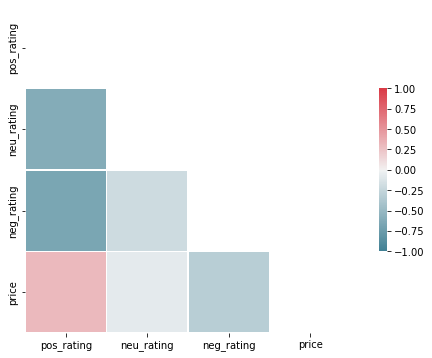

In [143]:
# Setting sentiment variables to a new dataframe
X = oct_2019[['pos_rating', 'neu_rating', 'neg_rating', 'price']]

# Heat Map
corr = X.corr()

# Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Set size of the plot
fig, ax = plt.subplots(figsize=(10,6))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmin = -1, vmax = 1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

Although the customers were assigned characters, the closeness between sentiment values does not show a strong correlation with price and sentiment rating. Positive ratings are slightly positively correlated with price, neutral ratings have almost no relationship with price, and negative ratings are slightly negatively correlated with price.

In [144]:
X = None

### K Means Clustering

In [145]:
# Setting data to new dataframe
df = oct_2019.copy()

In [146]:
# Splitting out the sentiment ratings
df_vars = df[['pos_rating', 'neu_rating', 'neg_rating', 'price']]

In [147]:
# Scaling the variable data and setting the price to a seperate variable
X = scale(df_vars[['pos_rating', 'neu_rating', 'neg_rating']])
y = pd.DataFrame(df['price'])
var_names = df_vars.columns

In [148]:
# # Creating another dataframe to serve as the scaled values
# df_vars_fit = df_vars.copy()

In [149]:
# scaler = MinMaxScaler()
# #scaler.fit(df[['price']])
# scaler.fit(df_vars_fit)
# # df['price_scaled'] = scaler.transform(df[['price']])
# df_vars_fit = scaler.transform(df_vars_fit)

In [150]:
distortions = []
inertias = []
K = range(1, 10)
 
for k in K:
    # Building and fitting the model
    kmeans = KMeans(n_clusters=k, n_init=10, random_state=73)
    kmeans.fit(X)
 
    distortions.append(sum(np.min(cdist(X, kmeans.cluster_centers_,
                                        'euclidean'), axis=1)) / X.shape[0])
    inertias.append(kmeans.inertia_)

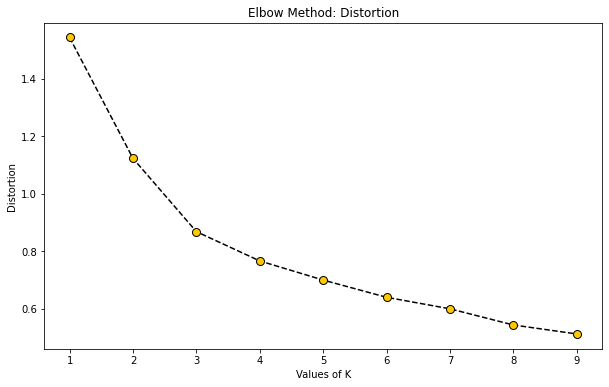

In [151]:
# Elbow plot: Distortion
plt.figure(figsize=(10,6))
plt.plot(K, distortions, 'bx-', color='black', linestyle='dashed', marker='o',
         markerfacecolor='#ffc800', markersize=8 )
plt.xlabel('Values of K')
plt.ylabel('Distortion')
plt.title('Elbow Method: Distortion')
#plt.show()
plt.savefig(output_graph+'Distortion.png', bbox_inches="tight")

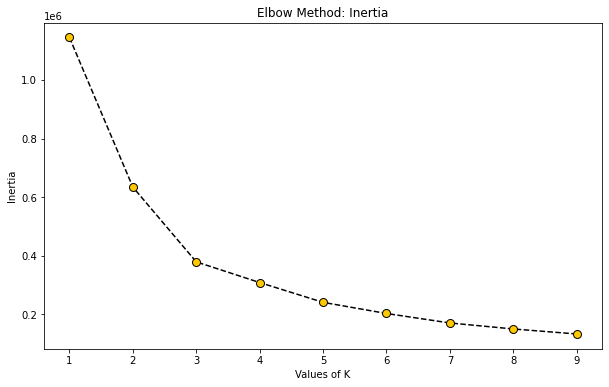

In [152]:
# Elbow plot: Inertia
plt.figure(figsize=(10,6))
plt.plot(K, inertias, 'bx-', color='black', linestyle='dashed', marker='o',
         markerfacecolor='#ffc800', markersize=8 )
plt.xlabel('Values of K')
plt.ylabel('Inertia')
plt.title('Elbow Method: Inertia')
plt.show()

In [153]:
kmeans = KMeans(n_clusters=3, n_init=10, random_state=73)
kmeans.fit(df_vars[['pos_rating', 'neu_rating', 'neg_rating']])
prediction = kmeans.fit_predict(df_vars)
df_vars['Cluster'] = prediction

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



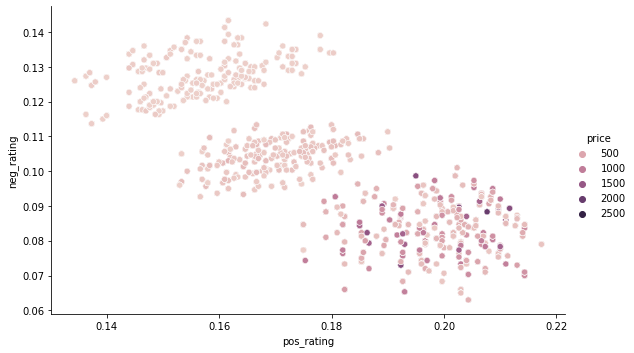

In [154]:
sns.relplot(data=df_vars, x='pos_rating', y='neg_rating', hue='price', aspect=1.61)
plt.show()

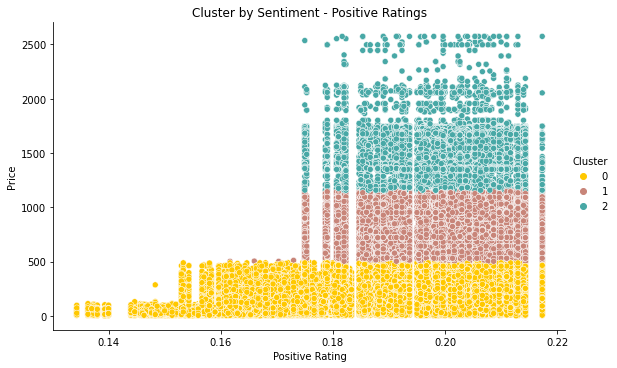

In [155]:
sns.relplot(data=df_vars, x='pos_rating', y='price', hue='Cluster', aspect=1.61, palette=my_colormap)
plt.xlabel('Positive Rating')
plt.ylabel('Price')
plt.title('Cluster by Sentiment - Positive Ratings')
#plt.show()
plt.savefig(output_graph+'Clusters.png', bbox_inches="tight")

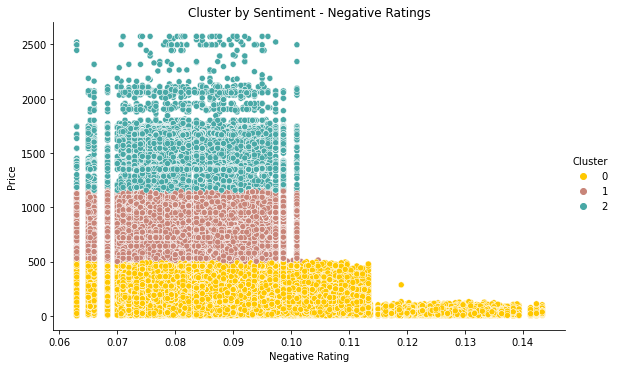

In [156]:
sns.relplot(data=df_vars, x='neg_rating', y='price', hue='Cluster', aspect=1.61, palette=my_colormap)
plt.xlabel('Negative Rating')
plt.ylabel('Price')
plt.title('Cluster by Sentiment - Negative Ratings')
plt.show()
#plt.savefig(output_graph+'Clusters.png')

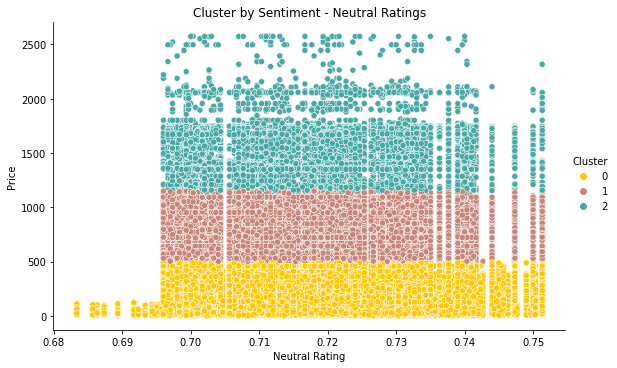

In [157]:
sns.relplot(data=df_vars, x='neu_rating', y='price', hue='Cluster', aspect=1.61, palette=my_colormap)
plt.xlabel('Neutral Rating')
plt.ylabel('Price')
plt.title('Cluster by Sentiment - Neutral Ratings')
plt.show()
#plt.savefig(output_graph+'Clusters.png')

Why it does not work:

/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:337: UserWarning:

The `size` parameter has been renamed to `height`; please update your code.



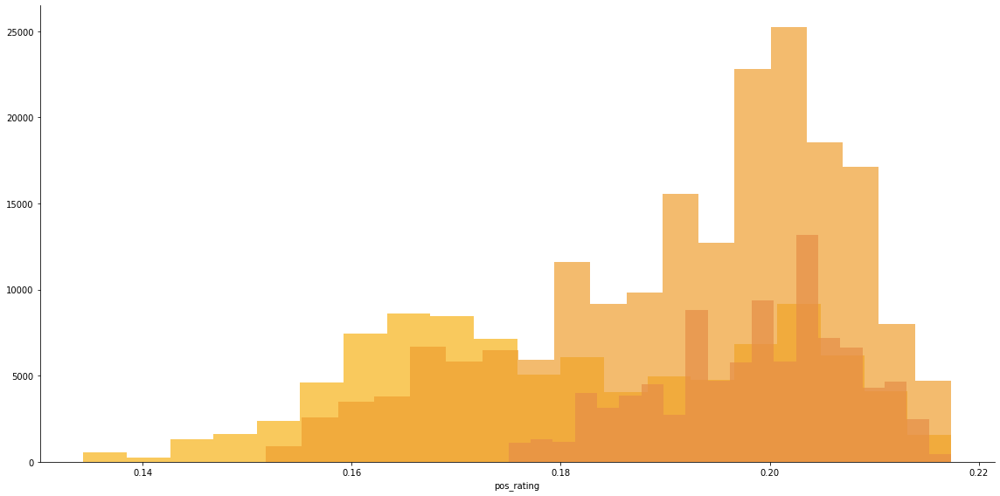

In [158]:
g = sns.FacetGrid(df,hue='spending_habit',palette=cpal,size=8,aspect=2)
g = g.map(plt.hist,'pos_rating',bins=20,alpha=0.7)

The ratings for each of the sentiments do not have a clear break between clusters when using three. The neutral ratings wash out the clear differences in positive ratings by price and negative ratings by price. Turning to regression or classification during the modeling phase will be key to making this proof of concept work.

In [159]:
df = None
df_vars = None

# Model

### Regression for Price

##### Linear Regresion - SKLearn

In [160]:
# Splitting out the independent variables
X = oct_2019[['pos_rating', 'neu_rating', 'neg_rating']]

# Assigning the dependent variable to 'y'
y = oct_2019['price']

# Scaling both variables
X = scale(X)
y = scale(y)

# Splitting the data to 30 percent test and 70 percent train
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=73)

# Printing the shape of the data
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

(267052, 3) (267052,)
(114452, 3) (114452,)


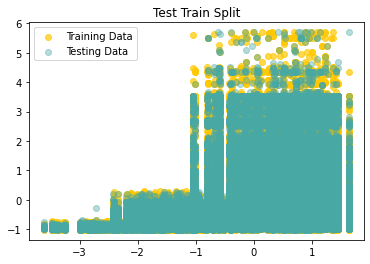

In [161]:
# Displaying both training and testing to see the split
plt.scatter(X_train[:,0], y_train, label='Training Data', color='#ffc800', alpha=.7)
plt.scatter(X_test[:,0], y_test, label='Testing Data', color='#48a8a6', alpha=.4)
plt.legend()
plt.title('Test Train Split')
plt.show()

The training and testing data plot shows a good mix for both values. Due to the created sentiment values, there are clear distinctions between negative, neutral, and positive values shown in the graph. Using regression for this data is going to have poor results as a line tries to fit the data.

In [162]:
# Instantiating the model
lr = LinearRegression()

# Fitting the model
lr.fit(X_train[:,0].reshape(-1,1), y_train)

LinearRegression()

In [163]:
# Making predictions
lr_pred = lr.predict(X_test[:,0].reshape(-1,1))

In [164]:
# Scoring the model accuracy
lr_accuracy = lr.score(X_test[:,0].reshape(-1,1), y_test)
print(f'Linear Regression - SKLearn Accuracy: {lr_accuracy}')

Linear Regression - SKLearn Accuracy: 0.097373842725894


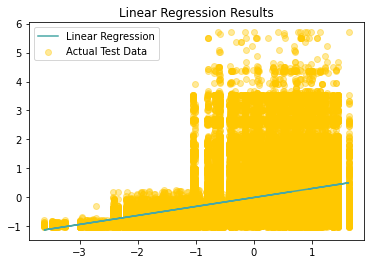

In [165]:
# Plotting the regression results
plt.plot(X_test[:,0], lr_pred, label='Linear Regression', color='#48a8a6')
plt.scatter(X_test[:,0], y_test, label='Actual Test Data', color='#ffc800', alpha=.4)
plt.legend()
plt.title('Linear Regression Results')
plt.show()

As confirmation, regression clearly has a tough time trying to model this data. The line seems to do a lot better with negative ratings but struggles as neutral and positive ratings have variable scaled pricing.

##### Linear Regresion - Statsmodel

Turning to another regression library with Statsmodel should confirm the poor conclusions found using linear regression.

In [166]:
# Creating a dataframe for input and output variables
X = oct_2019[['pos_rating', 'neu_rating', 'neg_rating', 'price']]

In [167]:
# Creating the regression formula using the sentiment ratings as independent variables and price for dependent variable
model = str('price ~ pos_rating + neu_rating + neg_rating')

# Fitting the model
model_fit = smf.ols(model, data = X).fit()

In [168]:
# Showing the model summary
print(model_fit.summary())

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.121
Model:                            OLS   Adj. R-squared:                  0.121
Method:                 Least Squares   F-statistic:                 1.743e+04
Date:                Sat, 18 Dec 2021   Prob (F-statistic):               0.00
Time:                        17:37:52   Log-Likelihood:            -2.7854e+06
No. Observations:              381504   AIC:                         5.571e+06
Df Residuals:                  381500   BIC:                         5.571e+06
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept  -4.111e+04   2288.863    -17.960      0.0

Statsmodel regression does support the findings from the SKLearn linear regression with a bad R-Squared value of 0.121. All three sentiment variables did show signficance with p-values under 0.05 but resulted in a poor overall model.

##### Random Forest

Testing regression one more time using Random Forest should result in slightly better findings due to the various "forests" created using this method.

In [169]:
# Creating a dataframe for input and output variables
X = oct_2019[['pos_rating', 'neu_rating', 'neg_rating']]

# Assigning the dependent variable to 'y'
y = oct_2019['price']

# Scaling both variables
X = scale(X)
y = scale(y)

# Splitting the data to 30 percent test and 70 percent train
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=73)

In [170]:
# Creating a timer
start = timeit.default_timer()

# List of estimators (or trees) to try
est_list = [10, 100, 500, 1000]

# Defining 0 for the best accuracy and best number of estimators
best_score, best_est = 0.0, 0

# Looping through the model and testing each estimator
for i in est_list:
  # Instantiating the regressor
  forest = RandomForestRegressor(n_estimators = i)

  # Fitting the model
  forest.fit(X_train, y_train.ravel())

  # Predict
  prediction = forest.predict(X_test)

  # R Square value
  r_square = metrics.r2_score(y_test, prediction)

  #print(f'Accuracy: {forest.score(X_test, y_test)}, Estimators: {i}')
  print(f'R-Square Value: {r_square}, Estimators: {i}')
  #predictions = forest.predict(X_test)
  
  if best_score < forest.score(X_test, y_test):
    best_score, best_est = forest.score(X_test, y_test), i

# Ending the timer
stop = timeit.default_timer()

# Printing the length of running the cell in minutes
print(f'Highest Accuracy: {best_score}, Best Estimators {best_est}')
print('Time: ', (stop - start)/60)

R-Square Value: 0.15425888819193423, Estimators: 10
R-Square Value: 0.15433942517521548, Estimators: 100
R-Square Value: 0.15435537929130505, Estimators: 500
R-Square Value: 0.15435225043181866, Estimators: 1000
Highest Accuracy: 0.15435537929130505, Best Estimators 500
Time:  6.5917159923166615


In [171]:
rf_regression_accuracy = best_score

### Classification for Spending Habits

In [172]:
# Shuffling the data
df = oct_2019.sample(frac=1)

In [173]:
# Creating a dataframe for input and output variables
X = df[['pos_rating', 'neu_rating', 'neg_rating']]

# Scaling the independent variables
X = scale(X)

# Assigning the categorical variable to 'y'
y = df['spending_habit']

# Splitting the data to 30 percent test and 70 percent train
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=73)

##### KNN - Classification

In [174]:
# Creating empty list to iterate to store K value errors
error_rate = []

# Creating a timer
start = timeit.default_timer()

best_rate, best_k = np.Inf, 0

# Creating the loop to test 1 to 40 for K value
for i in range(1,50):

  # Instantiating the classifier
  knn = KNeighborsClassifier(n_neighbors=i)

  # Fitting the model
  knn.fit(X_train, y_train)

  # Making predictions on the testing data
  pred_i = knn.predict(X_test)

  # Average error rate where predictions were NOT equal to the actual test value
  error_rate.append(np.mean(pred_i != y_test))
  #print('Completed K = ', i, ', Error Rate = ', np.mean(pred_i != y_test))

  if np.mean(pred_i != y_test) < best_rate:
    best_rate, best_k = np.mean(pred_i != y_test), i

  if i % 10 == 0:
    print(f'Current Best Error: {best_rate}, Current Best K Value: {best_k}')

print(f'Best Error Rate: {best_rate}, Best K Value: {best_k}')

# Ending the timer
stop = timeit.default_timer()

# Printing the length of running the cell in minutes
print('Time: ', (stop - start)/60)

Current Best Error: 0.5144252612448886, Current Best K Value: 9
Current Best Error: 0.49149861950861495, Current Best K Value: 20
Current Best Error: 0.47771991752000836, Current Best K Value: 30
Current Best Error: 0.47232901128857513, Current Best K Value: 40
Best Error Rate: 0.4676720371858945, Best K Value: 46
Time:  5.817477185683341


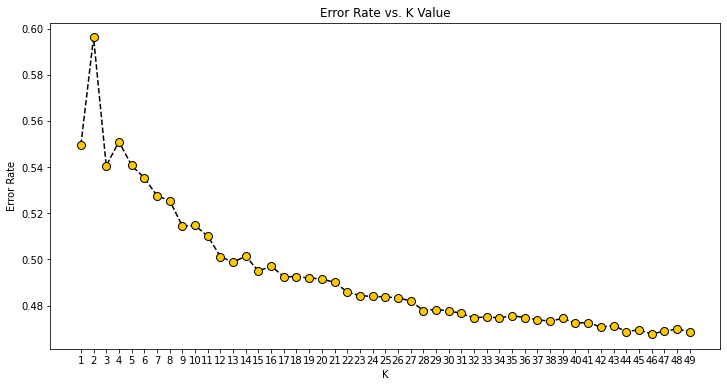

In [175]:
# Plotting the results

# Creating the figure
plt.figure(figsize=(12,6))

# Setting the x values as each K
plt.xticks(range(1,50))

# Plotting the values
plt.plot(range(1,50),error_rate,color='black', linestyle='dashed', marker='o',
         markerfacecolor='#ffc800', markersize=8)

# Adding a title and axis labels
plt.title('Error Rate vs. K Value')
plt.xlabel('K')
plt.ylabel('Error Rate')
plt.savefig(output_graph+'K_Values.png')

The best K value found through testing 1 to 50 values came out to 45. Based on the graph plot, it looks like the error rate slowly stabalizes just under 0.48. As the K values tested increases past 49, the expectation is to see the error rate start to increase in value.

In [176]:
# Using 4 as the best number of neighbors
knn = KNeighborsClassifier(n_neighbors=best_k)

# Fitting the data
knn.fit(X_train, y_train)

# Predictions
knn_pred = knn.predict(X_test)

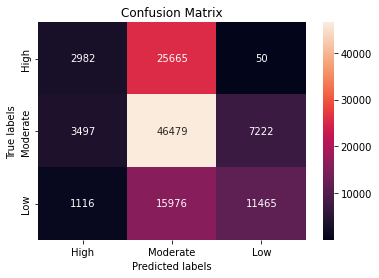

In [177]:
# Confusion Matrix
c_matrix = confusion_matrix(y_test, knn_pred, labels=['High', 'Moderate', 'Low'])

# Plotting confusion matrix
ax= plt.subplot()
sns.heatmap(c_matrix, annot=True, fmt='g', ax=ax);

# labels, title and ticks
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(['High', 'Moderate', 'Low']); ax.yaxis.set_ticklabels(['High', 'Moderate', 'Low']);

In [178]:
# Classification Report
print(classification_report(y_test, knn_pred))

              precision    recall  f1-score   support

        High       0.39      0.10      0.16     28697
         Low       0.61      0.40      0.48     28557
    Moderate       0.53      0.81      0.64     57198

    accuracy                           0.53    114452
   macro avg       0.51      0.44      0.43    114452
weighted avg       0.51      0.53      0.48    114452



The overall accuracy of 53 percent is not ideal and the precision and recall scores also highlight challenges in leaning on those values.

In [179]:
# Getting accuracy score
knn_accuracy = accuracy_score(y_test, knn_pred)

In [180]:
# Print accuracy
print('Overall Accuracy for KNN - Classification: ', knn_accuracy)

Overall Accuracy for KNN - Classification:  0.5323279628141054


##### Random Forest - Classification

In [181]:
# Creating a timer
start = timeit.default_timer()

# List of estimators (or trees) to try
est_list = [250, 500, 1000]

# Defining 0 for the best accuracy and best number of estimators
best_score, best_est = 0.0, 0

# Looping through the model and testing each estimator
for i in est_list:
  # Instantiating the classifier
  forest = RandomForestClassifier(n_estimators = i, random_state=73)

  # Fitting the model
  forest.fit(X_train, y_train)

  print(f'Accuracy: {forest.score(X_test, y_test)}, Estimators: {i}')
  #predictions = forest.predict(X_test)
  
  if best_score < forest.score(X_test, y_test):
    best_score, best_est = forest.score(X_test, y_test), i

# Ending the timer
stop = timeit.default_timer()

# Printing the length of running the cell in minutes
print(f'Highest Accuracy: {best_score}, Best Estimators {best_est}')
print('Time in Minutes: ', (stop - start)/60)

Accuracy: 0.5381557334078915, Estimators: 250
Accuracy: 0.5381557334078915, Estimators: 500
Accuracy: 0.5381557334078915, Estimators: 1000
Highest Accuracy: 0.5381557334078915, Best Estimators 250
Time in Minutes:  6.383778725116675


In [182]:
# Instantiating the classifier
forest = RandomForestClassifier(n_estimators = best_est, random_state=73)

# Fitting the model
forest.fit(X_train, y_train)

# Making Predictions
rf_class_pred = forest.predict(X_test)

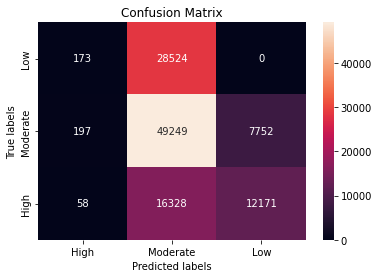

In [183]:
# Confusion Matrix
c_matrix = confusion_matrix(y_test, rf_class_pred, labels=['High', 'Moderate', 'Low'])

# Plotting confusion matrix
ax= plt.subplot()
sns.heatmap(c_matrix, annot=True, fmt='g', ax=ax);

# labels, title and ticks
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(['High', 'Moderate', 'Low']); ax.yaxis.set_ticklabels(['Low', 'Moderate', 'High']);

In [184]:
# Classification Report
print(classification_report(y_test, rf_class_pred))

              precision    recall  f1-score   support

        High       0.40      0.01      0.01     28697
         Low       0.61      0.43      0.50     28557
    Moderate       0.52      0.86      0.65     57198

    accuracy                           0.54    114452
   macro avg       0.51      0.43      0.39    114452
weighted avg       0.52      0.54      0.45    114452



In [185]:
rf_class_accuracy = accuracy_score(y_test, rf_class_pred)

In [186]:
# Print accuracy
print('Overall Accuracy for Random Forest - Classification: ', rf_class_accuracy)

Overall Accuracy for Random Forest - Classification:  0.5381557334078915


##### Bayes - Classification

In [187]:
# Initialize our classifier
gnb = GaussianNB()

# Train our classifier
model = gnb.fit(X_train, y_train)

# Make predictions
bayes_pred = gnb.predict(X_test)

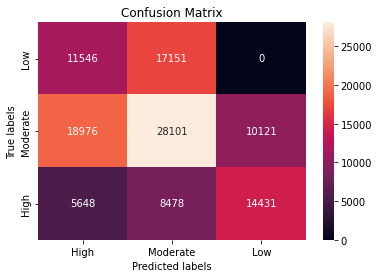

In [188]:
# Confusion Matrix
c_matrix = confusion_matrix(y_test, bayes_pred, labels=['High', 'Moderate', 'Low'])
                            
# Plotting confusion matrix
ax= plt.subplot()
sns.heatmap(c_matrix, annot=True, fmt='g', ax=ax);

# labels, title and ticks
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(['High', 'Moderate', 'Low']); ax.yaxis.set_ticklabels(['Low', 'Moderate', 'High']);

In [189]:
# Classification Report
print(classification_report(y_test, bayes_pred))

              precision    recall  f1-score   support

        High       0.32      0.40      0.36     28697
         Low       0.59      0.51      0.54     28557
    Moderate       0.52      0.49      0.51     57198

    accuracy                           0.47    114452
   macro avg       0.48      0.47      0.47    114452
weighted avg       0.49      0.47      0.48    114452



In [190]:
bayes_accuracy = accuracy_score(y_test, bayes_pred)

In [191]:
# Print accuracy
print('Overall Accuracy for Bayes - Classification: ', bayes_accuracy)

Overall Accuracy for Bayes - Classification:  0.4724950197462692


##### SVM - Classification

Takes about three hours in total to run

In [192]:
def param_query(X,y):
  # Creating a grid of parameters
  param_grid = {'C': [0.1,1, 10, 100, 1000], 'gamma': [1,0.1,0.01,0.001,0.0001], 'kernel': ['rbf']}

  # Instantiation of GridSearchCV: estimater (SVM), grid, and a verbose (text output)
  grid = GridSearchCV(SVC(random_state=73),param_grid,refit=True,verbose=3,n_jobs=-1)

  # Fitting the model
  grid.fit(X,y)

  # Printing the best output
  print(grid.best_params_)

In [193]:
# Creating a timer
start = timeit.default_timer()

# Subsetting the first 5000 points data to feed through GridSearch to find the best parameters
X = X_train[:5000]
y = y_train[:5000]

param_query(X,y)

# Ending the timer
stop = timeit.default_timer()

print('\n')
print('Time in Minutes: ', (stop - start)/60)

Fitting 5 folds for each of 25 candidates, totalling 125 fits
{'C': 100, 'gamma': 0.0001, 'kernel': 'rbf'}


Time in Minutes:  18.688467541583336


In [194]:
# Creating a timer
start = timeit.default_timer()

# Define the model
model = SVC(C=10,gamma=0.1,kernel='rbf',random_state=73)

# Fit the model
model.fit(X_train,y_train)

# Make predictions
svm_pred = model.predict(X_test)

# Ending the timer
stop = timeit.default_timer()

print('Time in Minutes: ', (stop - start)/60)

Time in Minutes:  182.0614800000667


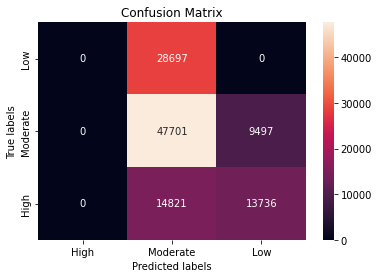

In [195]:
# Confusion Matrix
c_matrix = confusion_matrix(y_test, svm_pred, labels=['High', 'Moderate', 'Low'])
                            
# Plotting confusion matrix
ax= plt.subplot()
sns.heatmap(c_matrix, annot=True, fmt='g', ax=ax);

# labels, title and ticks
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(['High', 'Moderate', 'Low']); ax.yaxis.set_ticklabels(['Low', 'Moderate', 'High']);

In [196]:
# Classification Report
print(classification_report(y_test, svm_pred))

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

        High       0.00      0.00      0.00     28697
         Low       0.59      0.48      0.53     28557
    Moderate       0.52      0.83      0.64     57198

    accuracy                           0.54    114452
   macro avg       0.37      0.44      0.39    114452
weighted avg       0.41      0.54      0.45    114452



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [197]:
svm_accuracy = accuracy_score(y_test, svm_pred)

In [198]:
# Print accuracy
print('Overall Accuracy for SVM - Classification: ', svm_accuracy)

Overall Accuracy for SVM - Classification:  0.5367927165973508


##### Artificial Neural Network

Takes about three hours in total to run

In [199]:
# Shuffling the data
df = oct_2019.sample(frac=1)

In [200]:
# Encoding the spending habit variables for ANN
df.loc[df['spending_habit'] == 'Low', 'spending_num'] = 0
df.loc[df['spending_habit'] == 'Moderate', 'spending_num'] = 1
df.loc[df['spending_habit'] == 'High', 'spending_num'] = 2

In [201]:
# Creating a dataframe for input and output variables
X = df[['pos_rating', 'neu_rating', 'neg_rating']]

# Scaling the independent variables
X = scale(X)

# Assigning the categorical variable to 'y'
y = df['spending_num']

# Splitting the data to 30 percent test and 70 percent train
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=73)

In [202]:
# Change the label to one hot encoding
y_train = to_categorical(y_train,num_classes=3)
y_test = to_categorical(y_test,num_classes=3)

# Printing the shape of the data
print("Shape of y_train",y_train.shape)
print("Shape of y_test",y_test.shape)

Shape of y_train (267052, 3)
Shape of y_test (114452, 3)


In [203]:
def build_model(hp):
  model = Sequential()

  # Adding between 1 to 4 hidden layers with relu activation
  for i in range(hp.Int('layers', 1, 4)):
    hp_units = hp.Int('units_' + str(i), min_value=100, max_value=1000, step=200)
    model.add(keras.layers.Dense(units=hp_units, activation='relu'))
  
  # Final output layer (using softmax due to the multiclass logistic with 10 output nodes due to 0 to 9 categories)
  model.add(Dense(3,activation='softmax'))

  # Compiling the model with varying learning rates
  hp_learning_rate = hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
  model.compile(optimizer=keras.optimizers.Adam(learning_rate=hp_learning_rate),
                loss='categorical_crossentropy',
                metrics=['accuracy'])
  
  return model

In [204]:
tuner = kt.Hyperband(
    build_model,
    objective='val_accuracy',
    max_epochs=5,
    factor=3,
    overwrite=True,
    directory='my_dir_test',
    project_name='ecom')

In [205]:
stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)

In [ ]:
tuner.search(X_train, y_train,
             epochs=25,
             validation_split=0.2,
             callbacks=[stop_early])

Trial 6 Complete [00h 01m 22s]
val_accuracy: 0.5380164980888367

Best val_accuracy So Far: 0.5380164980888367
Total elapsed time: 00h 09m 21s

Search: Running Trial #7

Hyperparameter    |Value             |Best Value So Far 
layers            |3                 |4                 
units_0           |900               |500               
learning_rate     |0.01              |0.01              
units_1           |300               |100               
units_2           |900               |100               
units_3           |900               |100               
tuner/epochs      |5                 |2                 
tuner/initial_e...|2                 |0                 
tuner/bracket     |1                 |1                 
tuner/round       |1                 |0                 
tuner/trial_id    |876c035f2ebd932...|None              

Epoch 3/5
6677/6677 [==============================] - 73s 11ms/step - loss: 0.9025 - accuracy: 0.5363 - val_loss: 0.8979 - val_accuracy: 0.5373
E

In [218]:
# Get the optimal hyperparameters
best_hps=tuner.get_best_hyperparameters(num_trials=1)[0]

print(f"""
The hyperparameter search is complete. The optimal number of layers is {best_hps.get('layers')} and the optimal learning rate for the optimizer
is {best_hps.get('learning_rate')}.
""")


The hyperparameter search is complete. The optimal number of layers is 4 and the optimal learning rate for the optimizer
is 0.01.



In [ ]:
# Build the model with the optimal hyperparameters and train it on the data for 50 epochs
model = tuner.hypermodel.build(best_hps)
history = model.fit(X_train, y_train, epochs=50, validation_split=0.2)

val_acc_per_epoch = history.history['val_accuracy']
best_epoch = val_acc_per_epoch.index(max(val_acc_per_epoch)) + 1
print('Best epoch: %d' % (best_epoch,))

Epoch 1/50
6677/6677 [==============================] - 23s 3ms/step - loss: 0.9015 - accuracy: 0.5369 - val_loss: 0.9004 - val_accuracy: 0.5303
Epoch 2/50
6677/6677 [==============================] - 23s 3ms/step - loss: 0.8993 - accuracy: 0.5371 - val_loss: 0.8982 - val_accuracy: 0.5357
Epoch 3/50
6677/6677 [==============================] - 22s 3ms/step - loss: 0.8985 - accuracy: 0.5395 - val_loss: 0.8974 - val_accuracy: 0.5380
Epoch 4/50
6677/6677 [==============================] - 22s 3ms/step - loss: 0.8980 - accuracy: 0.5392 - val_loss: 0.8981 - val_accuracy: 0.5380
Epoch 5/50
6677/6677 [==============================] - 22s 3ms/step - loss: 0.8984 - accuracy: 0.5379 - val_loss: 0.8972 - val_accuracy: 0.5380
Epoch 6/50
6677/6677 [==============================] - 22s 3ms/step - loss: 0.8976 - accuracy: 0.5380 - val_loss: 0.8988 - val_accuracy: 0.5380
Epoch 7/50
6677/6677 [==============================] - 21s 3ms/step - loss: 0.8977 - accuracy: 0.5391 - val_loss: 0.8973 - val_ac

In [ ]:
tuner.results_summary()

In [ ]:
# Re-instantiate the hypermodel and train it with the optimal number of epochs from above.
hypermodel = tuner.hypermodel.build(best_hps)

# Retrain the model
hypermodel.fit(X_train, y_train, epochs=best_epoch, validation_split=0.2)

In [ ]:
# Evaluate on test data
eval_result = hypermodel.evaluate(X_test, y_test)
print("[test loss, test accuracy]:", eval_result)

In [ ]:
ann_accuracy = eval_result[1]

# Interpret

Include the accuracy results, both plot and table (because he loves tables)

In [ ]:
df_accuracy = pd.DataFrame()
df_accuracy = df_accuracy.append({'Model': 'KNN - Classification', 'Accuracy': knn_accuracy}, ignore_index=True)
df_accuracy = df_accuracy.append({'Model': 'Random Forest - Classification', 'Accuracy': rf_class_accuracy}, ignore_index=True)
df_accuracy = df_accuracy.append({'Model': 'Bayes - Classification', 'Accuracy': bayes_accuracy}, ignore_index=True)
df_accuracy = df_accuracy.append({'Model': 'SVM - Classification', 'Accuracy': svm_accuracy}, ignore_index=True)
df_accuracy = df_accuracy.append({'Model': 'ANN - Classification', 'Accuracy': ann_accuracy}, ignore_index=True)
df_accuracy = df_accuracy.append({'Model': 'SKLearn Linear - Regression', 'Accuracy': lr_accuracy}, ignore_index=True)
df_accuracy = df_accuracy.append({'Model': 'Random Forest - Regression', 'Accuracy': rf_regression_accuracy}, ignore_index=True)

In [ ]:
df_accuracy.to_csv(output_path+'model_accuracy')

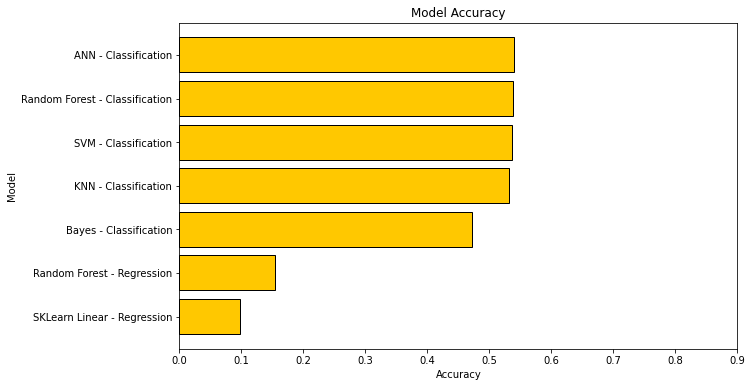

In [216]:
# Creating a plot
plt.figure(figsize=(10,6))
plt.barh('Model', 'Accuracy', data=df_accuracy.sort_values(by='Accuracy', ascending=True), edgecolor='black',color=['#ffc800'])
plt.ylabel('Model')
plt.xlabel('Accuracy')
plt.title('Model Accuracy')
plt.xticks(np.arange(0, 1, step=0.1))
plt.show()
#plt.savefig(output_graph+'Model_Accuracy.png', bbox_inches="tight")

In [217]:
df_accuracy

,Accuracy,Model
0,0.532328,KNN - Classification
1,0.538156,Random Forest - Classification
2,0.472495,Bayes - Classification
3,0.536793,SVM - Classification
4,0.540104,ANN - Classification
5,0.097374,SKLearn Linear - Regression
6,0.154355,Random Forest - Regression
